# CLIP (Constrasitive Language and Image Pre-trained model) test

In [1]:
# https://github.com/openai/CLIP

In [2]:
#Check CUDA and torch version
import subprocess

CUDA_version = [s for s in subprocess.check_output(["nvcc", "--version"]).decode("UTF-8").split(", ") if s.startswith("release")][0].split(" ")[-1]
print("CUDA version:", CUDA_version)
""""
if CUDA_version == "10.0":
    torch_version_suffix = "+cu100"
elif CUDA_version == "10.1":
    torch_version_suffix = "+cu101"
elif CUDA_version == "10.2":
    torch_version_suffix = ""
else:
    torch_version_suffix = "+cu110"

#!pip install torch==1.7.1{torch_version_suffix} torchvision==0.8.2{torch_version_suffix} -f https://download.pytorch.org/whl/torch_stable.html ftfy regex
"""
import numpy as np
import torch
import os

print("Torch version:", torch.__version__)
#os.kill(os.getpid(), 9)


CUDA version: 10.2
Torch version: 1.8.0


## Improve accuracy with Image Embedding + Text Embedding

['7874222803-sugar', '4157005670-almondmilk', '8491201426-HoneyBunch', '8113118392-tussin', '8113106123-tussin_max', '7874212406-sweetner', '1015803449-Cleanser', '4400004575-RitzCracker', '3600041777-Wipes', '41331112406-Beans', '1411391254-Pistachios', '8616220043-water', '7203002209-littleBite', '4000055113-m&mMilk', '1800012323-miniBiscuits', '4000051121-m&mPeanut', '3528244925-toyPenguin', '1920089962-SurfaceCleaner', '1600017819-berryCereal', '5000015991-evaporatedMilk', '7314115315-oreoPocky', '7232075003-pandaCookie', '787423717-taco', '4300020056-limeJello', '4300020053-cherryJello', '1370037299-Ziplock', '4288742634-dishwasherCleaner', '000000-lemon', '6416410193-BlueBerryBun', '84576204143-galaApple', '800016643095-Chips', '9413844-FujiApple', '11111-Egg', '22222-Banana', '33333-Butter', '44444-DietCoke', '55555-Coke']
['Great Value Pure Granulated Sugar 4 lb', 'Blue Diamond Almond Breeze milk Unsweetened Original Almond Milk, Half Gallon, 64 fl oz', 'Honey Bunches of Oats H

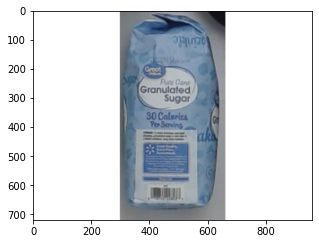

7874222803-sugar :   predicted as  4157005670-almondmilk 0.819


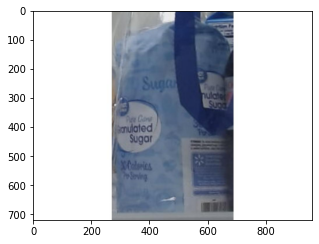

7874222803-sugar :   predicted as  7874222803-sugar 0.9497


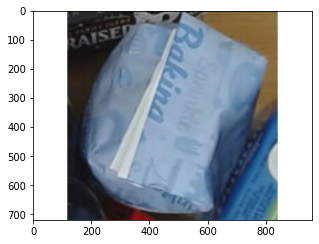

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.6353


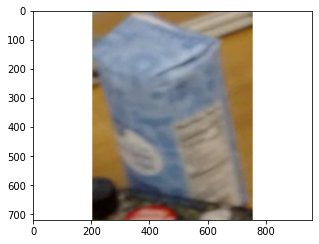

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.278


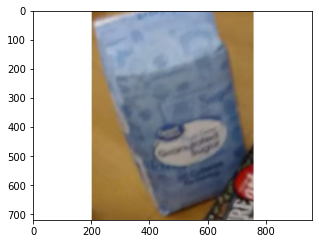

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.4568


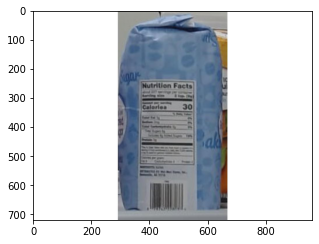

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.6714


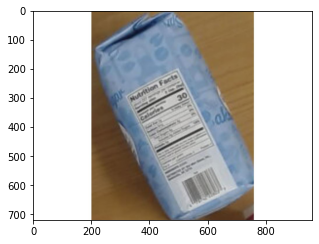

7874222803-sugar :   predicted as  1800012323-miniBiscuits 0.1903


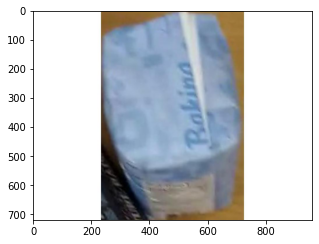

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.4155


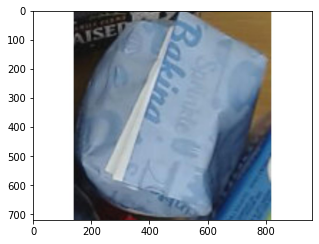

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.4158


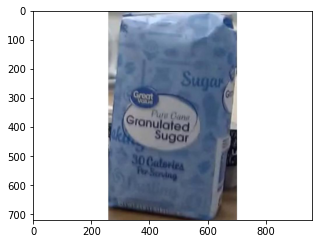

7874222803-sugar :   predicted as  7874222803-sugar 0.9224


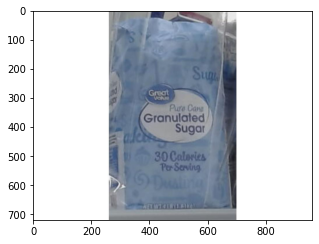

7874222803-sugar :   predicted as  7874222803-sugar 0.72


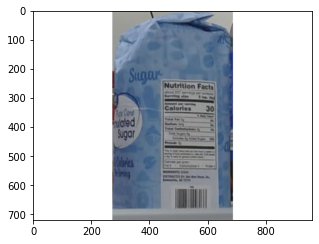

7874222803-sugar :   predicted as  1370037299-Ziplock 0.494


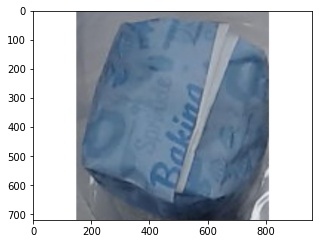

7874222803-sugar :   predicted as  84576204143-galaApple 0.2175


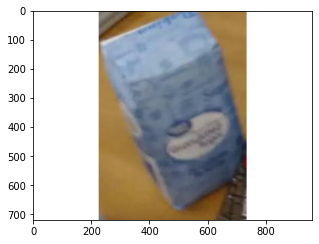

7874222803-sugar :   predicted as  1800012323-miniBiscuits 0.415


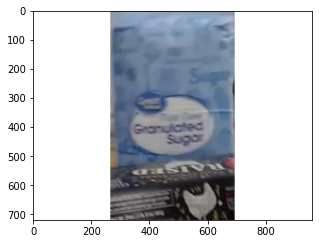

7874222803-sugar :   predicted as  7874222803-sugar 0.444


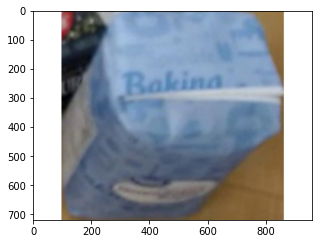

7874222803-sugar :   predicted as  84576204143-galaApple 0.63


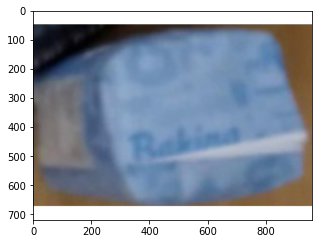

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.3528


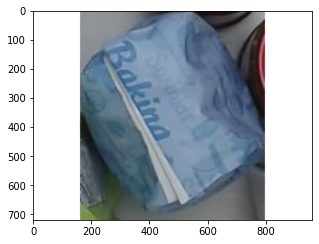

7874222803-sugar :   predicted as  84576204143-galaApple 0.237


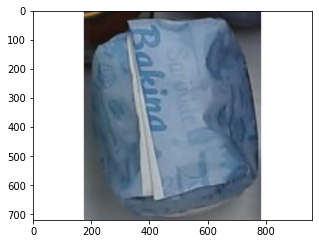

7874222803-sugar :   predicted as  84576204143-galaApple 0.2651


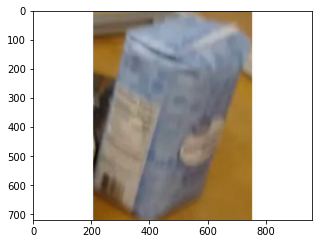

7874222803-sugar :   predicted as  55555-Coke 0.3076


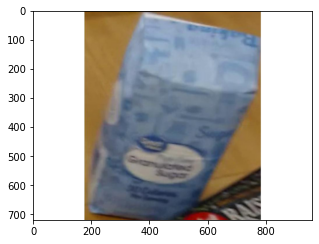

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.712


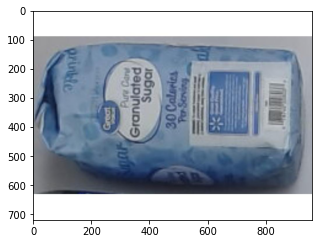

7874222803-sugar :   predicted as  3600041777-Wipes 0.314


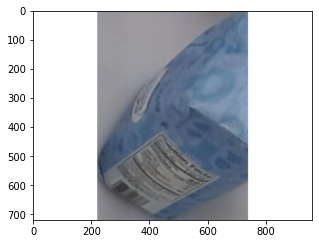

7874222803-sugar :   predicted as  1370037299-Ziplock 0.681


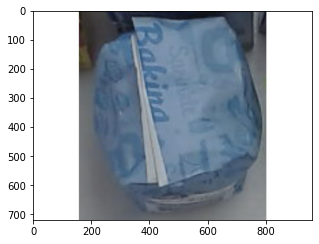

7874222803-sugar :   predicted as  1800012323-miniBiscuits 0.601


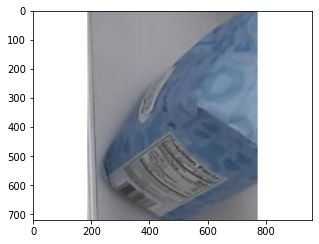

7874222803-sugar :   predicted as  3600041777-Wipes 0.3572


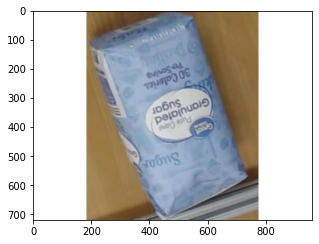

7874222803-sugar :   predicted as  7874222803-sugar 0.518


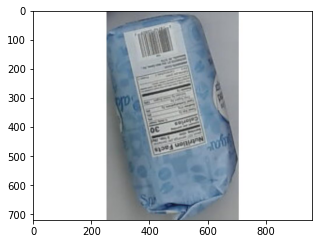

7874222803-sugar :   predicted as  33333-Butter 0.2201


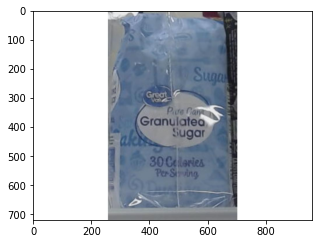

7874222803-sugar :   predicted as  7874222803-sugar 0.9946


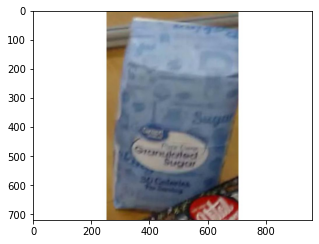

7874222803-sugar :   predicted as  33333-Butter 0.2883


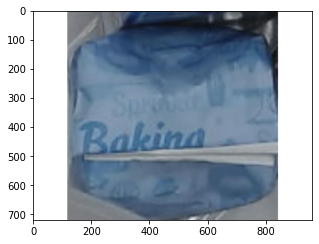

7874222803-sugar :   predicted as  33333-Butter 0.792


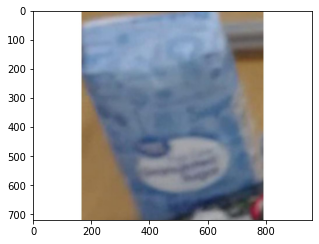

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.6987


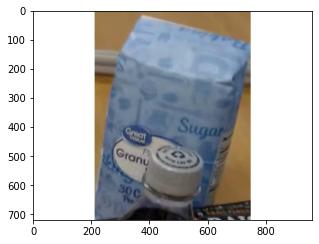

7874222803-sugar :   predicted as  7874222803-sugar 0.6514


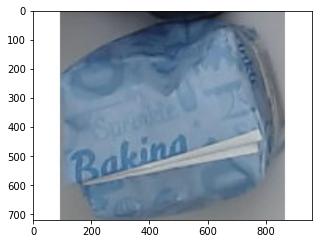

7874222803-sugar :   predicted as  84576204143-galaApple 0.4895


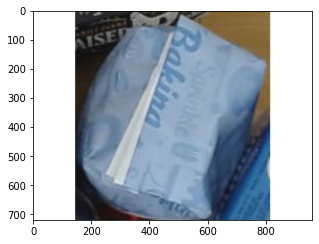

7874222803-sugar :   predicted as  33333-Butter 0.2422


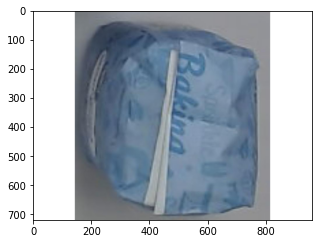

7874222803-sugar :   predicted as  84576204143-galaApple 0.3394


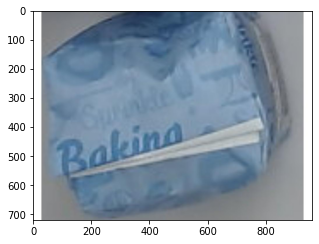

7874222803-sugar :   predicted as  84576204143-galaApple 0.4973


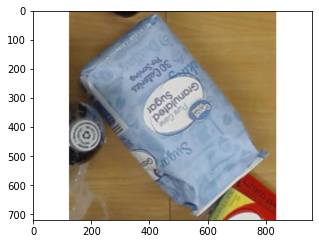

7874222803-sugar :   predicted as  7874222803-sugar 0.3271


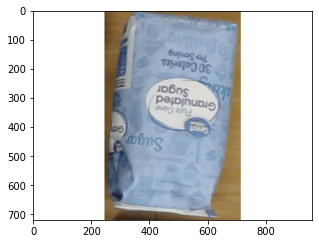

7874222803-sugar :   predicted as  7874222803-sugar 0.3687


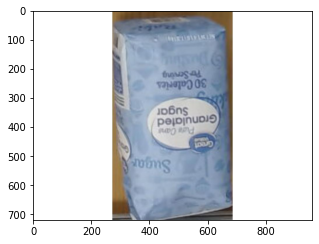

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.4304


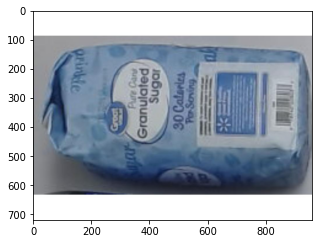

7874222803-sugar :   predicted as  4157005670-almondmilk 0.3323


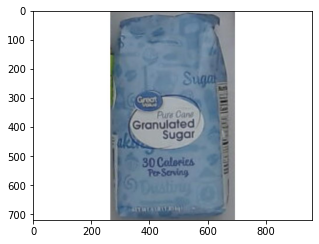

7874222803-sugar :   predicted as  7874222803-sugar 0.936


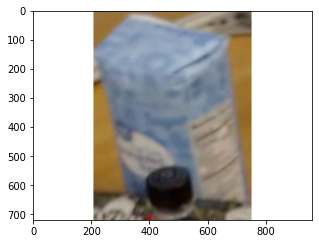

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.4038


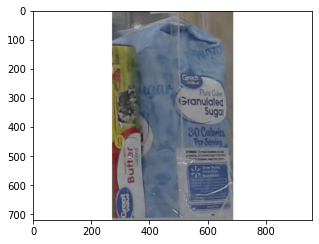

7874222803-sugar :   predicted as  1370037299-Ziplock 0.3442


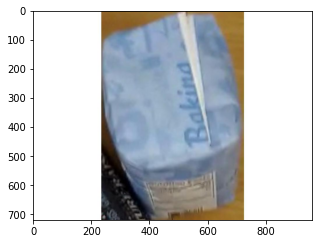

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.4194


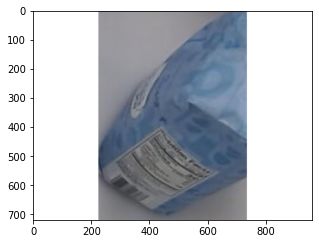

7874222803-sugar :   predicted as  1370037299-Ziplock 0.4688


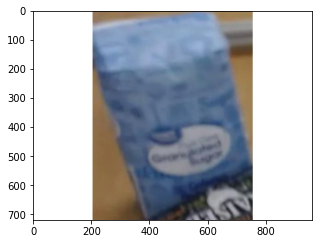

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.3806


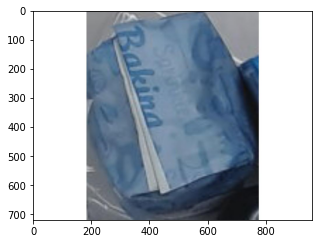

7874222803-sugar :   predicted as  3600041777-Wipes 0.4912


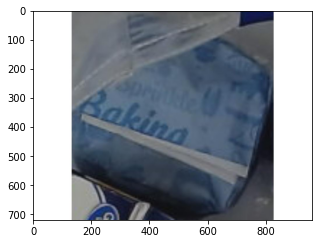

7874222803-sugar :   predicted as  1800012323-miniBiscuits 0.4426


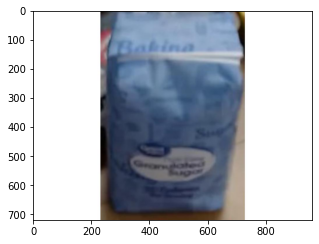

7874222803-sugar :   predicted as  7203002209-littleBite 0.252


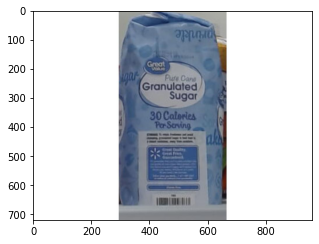

7874222803-sugar :   predicted as  4157005670-almondmilk 0.6846


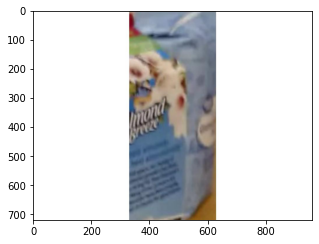

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.8726


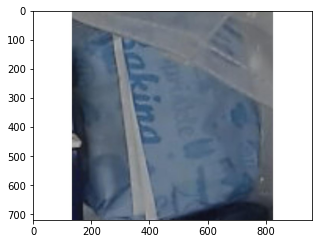

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.2905


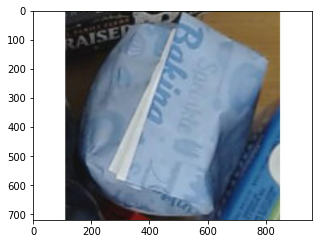

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.4006


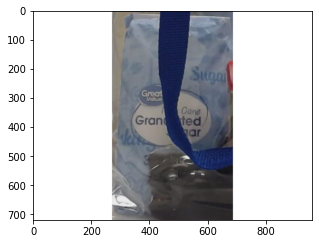

7874222803-sugar :   predicted as  33333-Butter 0.4438


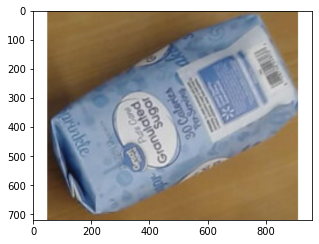

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.5776


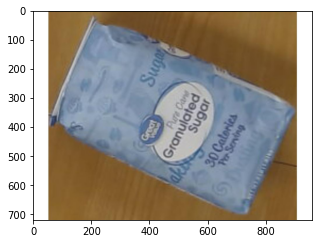

7874222803-sugar :   predicted as  33333-Butter 0.4055


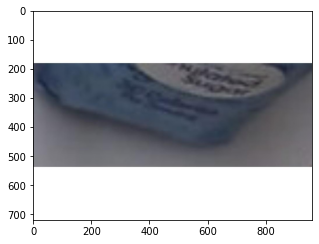

7874222803-sugar :   predicted as  7874222803-sugar 0.2847


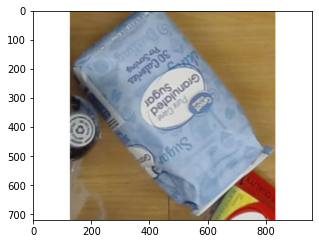

7874222803-sugar :   predicted as  1800012323-miniBiscuits 0.5293


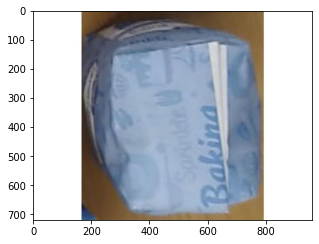

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.2498


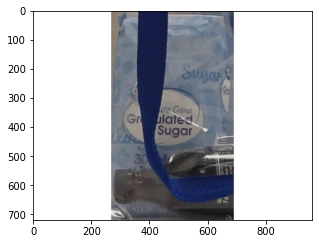

7874222803-sugar :   predicted as  7874222803-sugar 0.8457


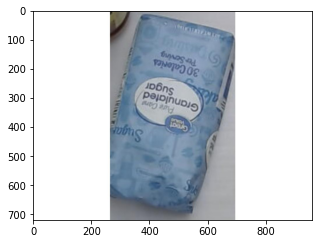

7874222803-sugar :   predicted as  1015803449-Cleanser 0.2443


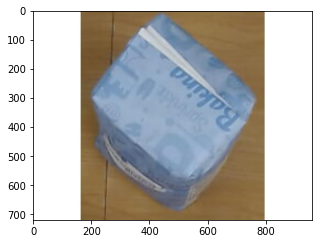

7874222803-sugar :   predicted as  1370037299-Ziplock 0.667


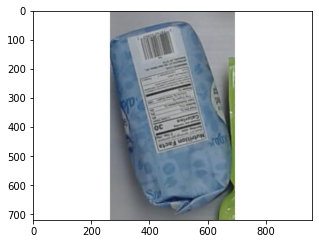

7874222803-sugar :   predicted as  1370037299-Ziplock 0.2683


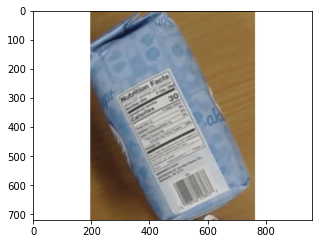

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.4521


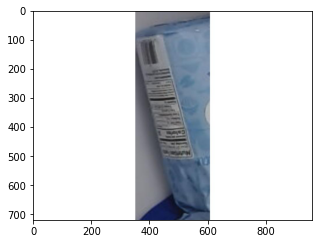

7874222803-sugar :   predicted as  1370037299-Ziplock 0.4253


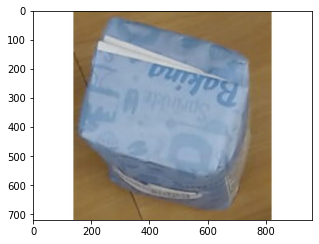

7874222803-sugar :   predicted as  1370037299-Ziplock 0.328


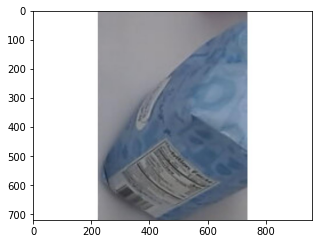

7874222803-sugar :   predicted as  1370037299-Ziplock 0.638


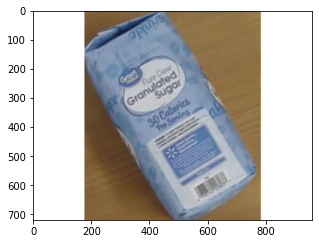

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.37


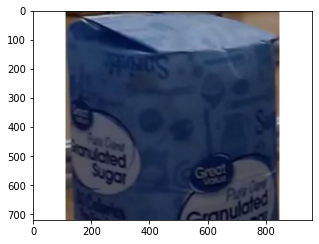

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.5806


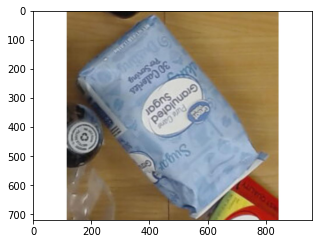

7874222803-sugar :   predicted as  1800012323-miniBiscuits 0.3667


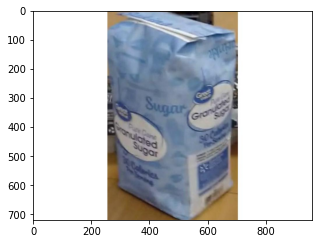

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.4285


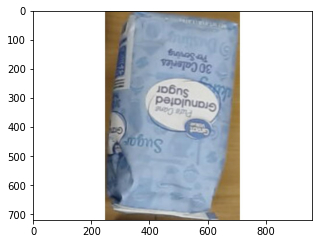

7874222803-sugar :   predicted as  3600041777-Wipes 0.3777


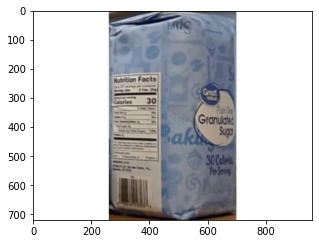

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.3298


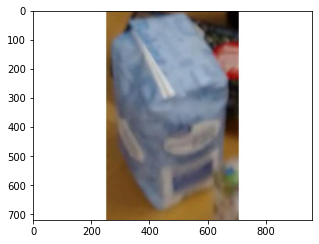

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.3203


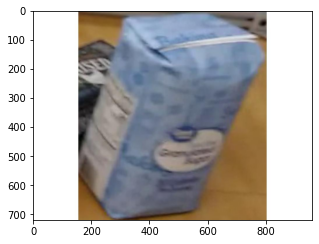

7874222803-sugar :   predicted as  7874222803-sugar 0.2751


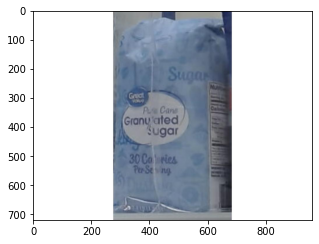

7874222803-sugar :   predicted as  7874222803-sugar 0.9775


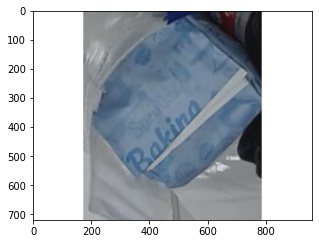

7874222803-sugar :   predicted as  84576204143-galaApple 0.3623


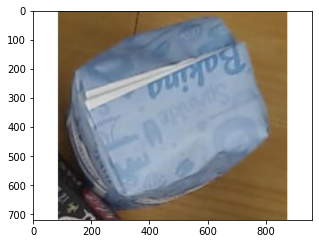

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.449


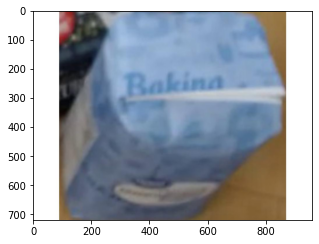

7874222803-sugar :   predicted as  84576204143-galaApple 0.4065


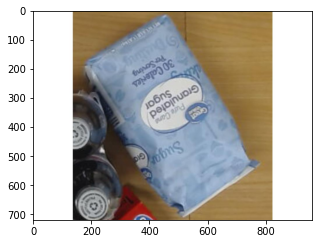

7874222803-sugar :   predicted as  1800012323-miniBiscuits 0.4163


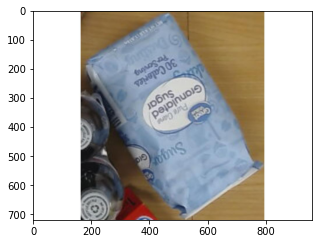

7874222803-sugar :   predicted as  7203002209-littleBite 0.357


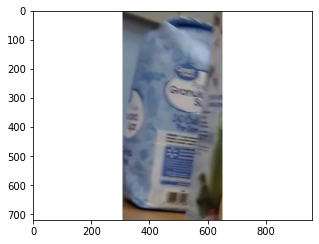

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.7217


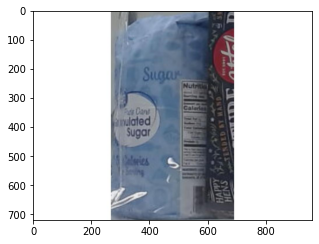

7874222803-sugar :   predicted as  7874222803-sugar 0.833


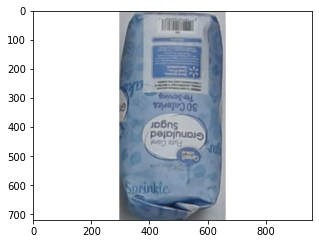

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.3054


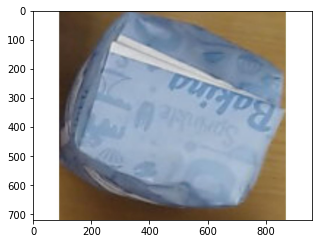

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.4126


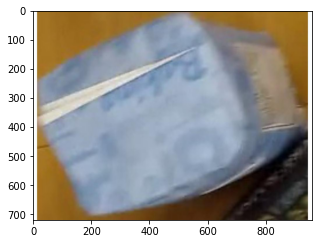

7874222803-sugar :   predicted as  55555-Coke 0.4548


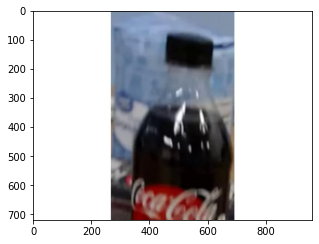

7874222803-sugar :   predicted as  55555-Coke 0.7534


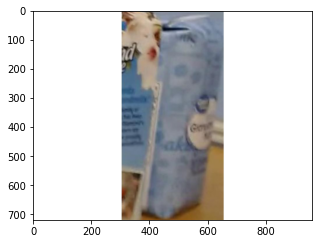

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.786


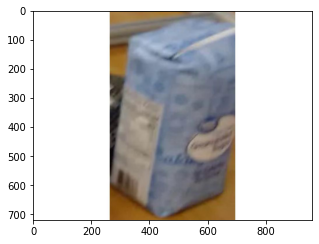

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.4573


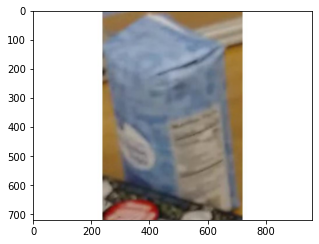

7874222803-sugar :   predicted as  7874222803-sugar 0.3381


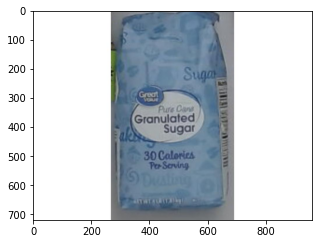

7874222803-sugar :   predicted as  7874222803-sugar 0.4578


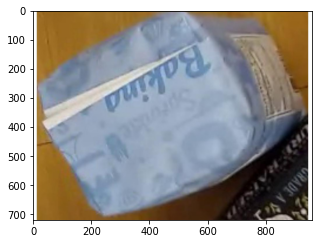

7874222803-sugar :   predicted as  55555-Coke 0.3584


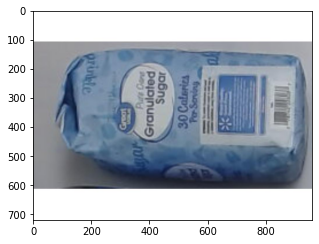

7874222803-sugar :   predicted as  4157005670-almondmilk 0.5005


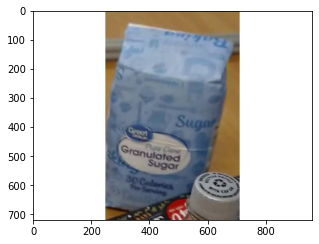

7874222803-sugar :   predicted as  7874222803-sugar 0.9526


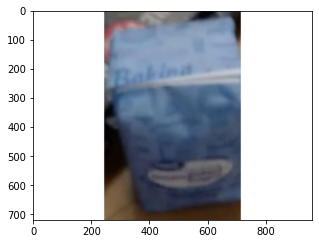

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.3242


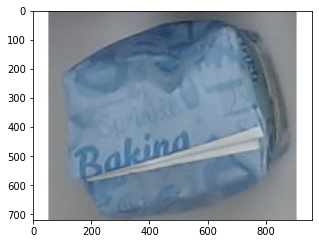

7874222803-sugar :   predicted as  84576204143-galaApple 0.4075


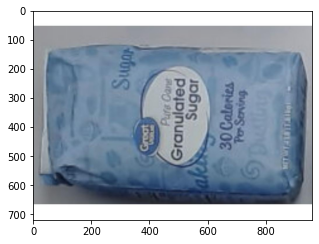

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.2886


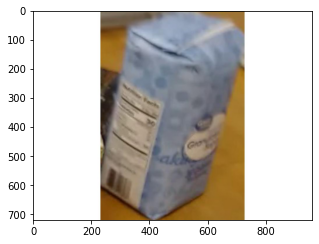

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.2067


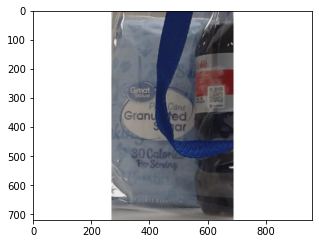

7874222803-sugar :   predicted as  7874222803-sugar 0.4712


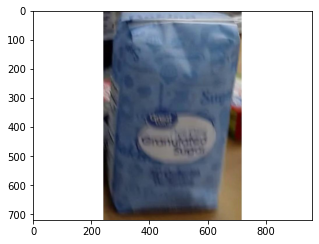

7874222803-sugar :   predicted as  1800012323-miniBiscuits 0.683


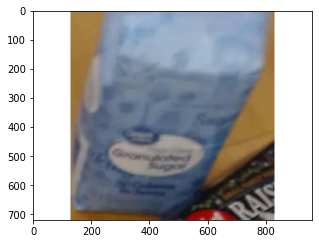

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.839


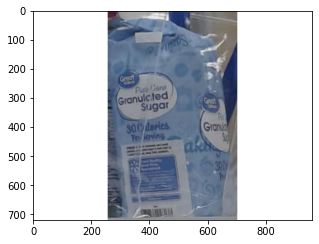

7874222803-sugar :   predicted as  7874222803-sugar 0.866


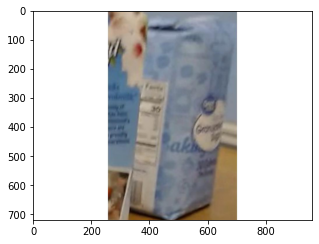

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.3772


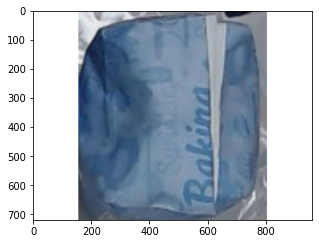

7874222803-sugar :   predicted as  1370037299-Ziplock 0.322


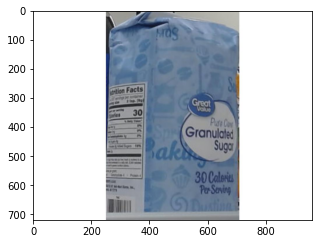

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.3337


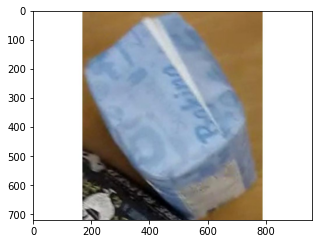

7874222803-sugar :   predicted as  33333-Butter 0.4639


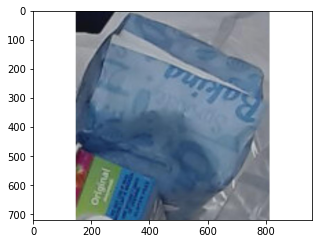

7874222803-sugar :   predicted as  3600041777-Wipes 0.2416


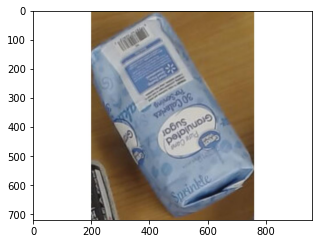

7874222803-sugar :   predicted as  4157005670-almondmilk 0.2776


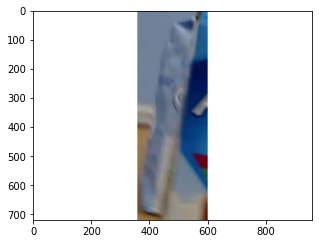

7874222803-sugar :   predicted as  44444-DietCoke 0.535


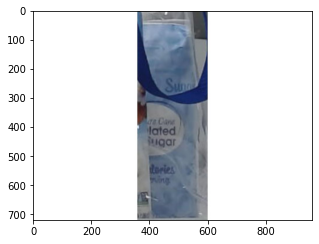

7874222803-sugar :   predicted as  33333-Butter 0.2778


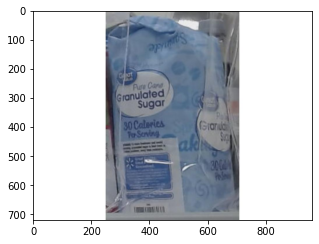

7874222803-sugar :   predicted as  7874222803-sugar 0.912


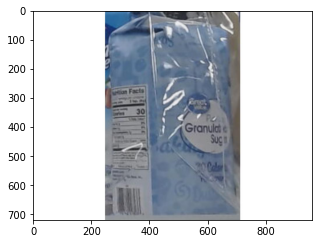

7874222803-sugar :   predicted as  1370037299-Ziplock 0.5996


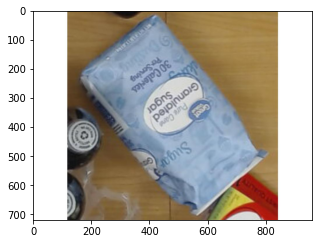

7874222803-sugar :   predicted as  4288742634-dishwasherCleaner 0.2046


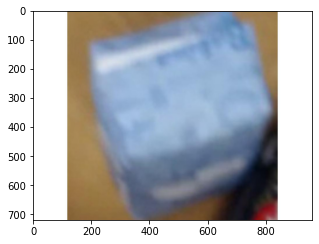

7874222803-sugar :   predicted as  55555-Coke 0.722


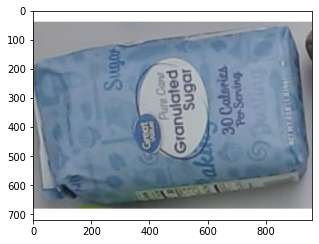

7874222803-sugar :   predicted as  1800012323-miniBiscuits 0.3367


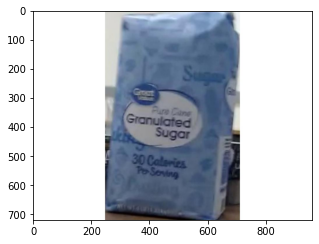

7874222803-sugar :   predicted as  7874222803-sugar 0.937


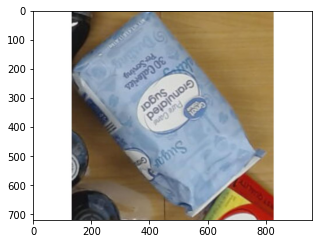

7874222803-sugar :   predicted as  1800012323-miniBiscuits 0.2917


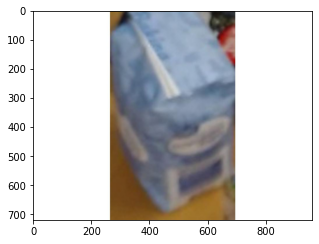

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.754


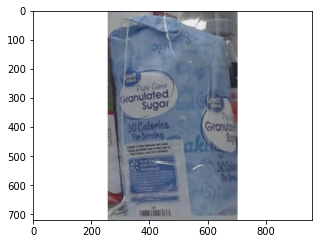

7874222803-sugar :   predicted as  7874222803-sugar 0.9307


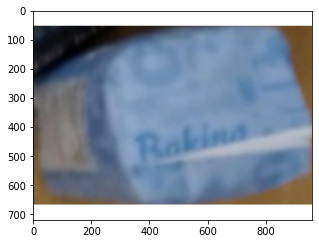

7874222803-sugar :   predicted as  55555-Coke 0.441


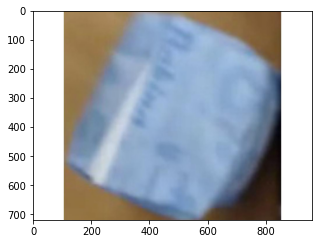

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.3816


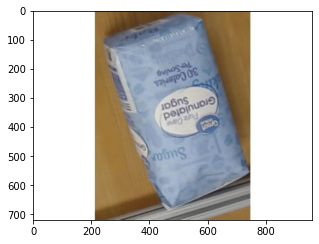

7874222803-sugar :   predicted as  1800012323-miniBiscuits 0.516


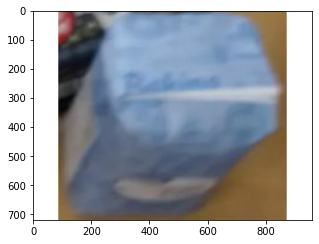

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.3005


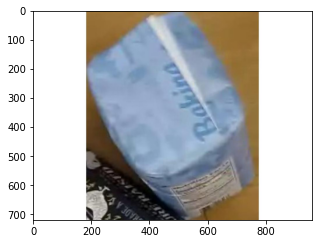

7874222803-sugar :   predicted as  33333-Butter 0.283


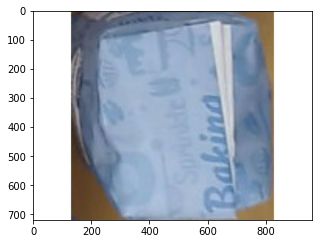

7874222803-sugar :   predicted as  4157005670-almondmilk 0.2351


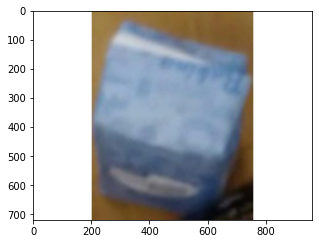

7874222803-sugar :   predicted as  3600041777-Wipes 0.735


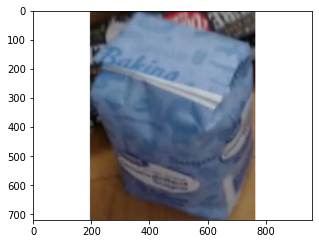

7874222803-sugar :   predicted as  1370037299-Ziplock 0.3735


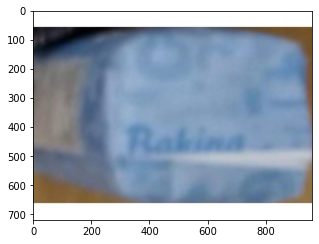

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.649


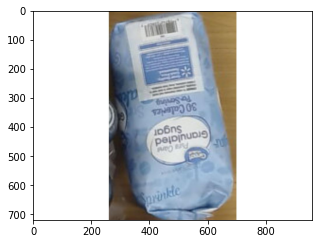

7874222803-sugar :   predicted as  7874222803-sugar 0.4778


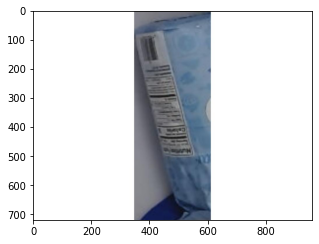

7874222803-sugar :   predicted as  1370037299-Ziplock 0.3464


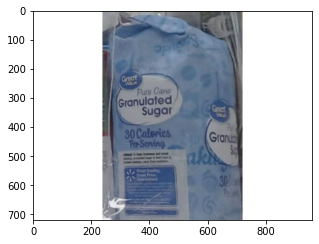

7874222803-sugar :   predicted as  7874222803-sugar 0.973


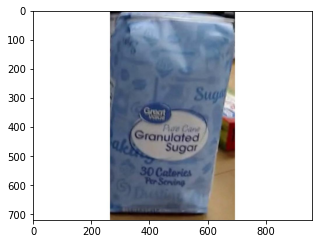

7874222803-sugar :   predicted as  7874222803-sugar 0.5327


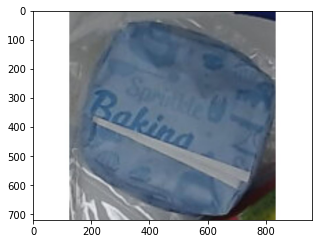

7874222803-sugar :   predicted as  84576204143-galaApple 0.4497


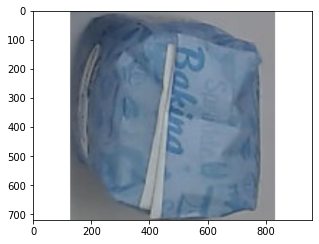

7874222803-sugar :   predicted as  84576204143-galaApple 0.3706


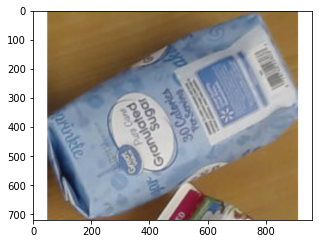

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.606


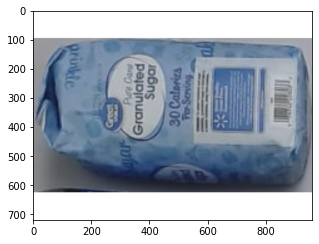

7874222803-sugar :   predicted as  3600041777-Wipes 0.283


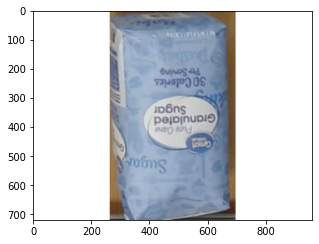

7874222803-sugar :   predicted as  7874222803-sugar 0.579


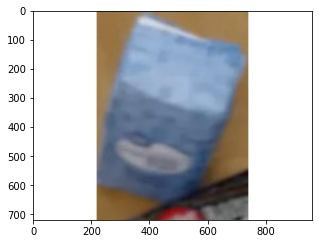

7874222803-sugar :   predicted as  5000015991-evaporatedMilk 0.3064


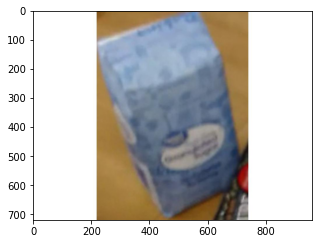

7874222803-sugar :   predicted as  3600041777-Wipes 0.3164

accuracy on class 7874222803-sugar is :0.19424460431654678


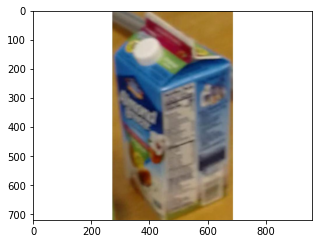

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7295


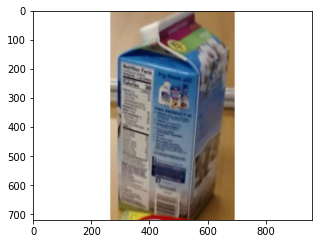

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.882


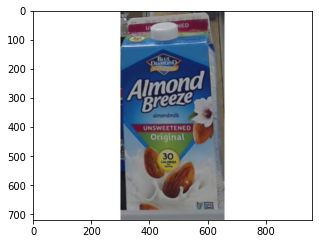

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.999


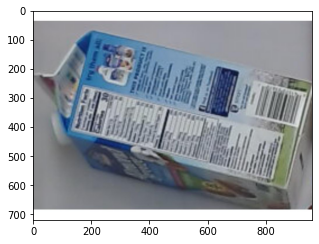

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7983


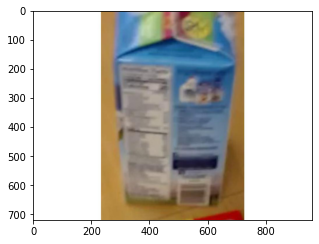

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7314


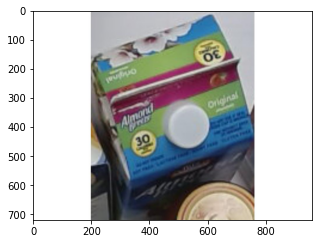

4157005670-almondmilk :   predicted as  33333-Butter 0.2195


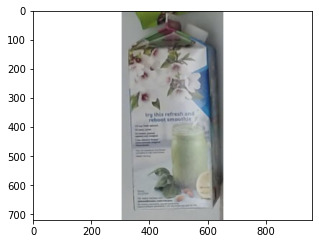

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.9604


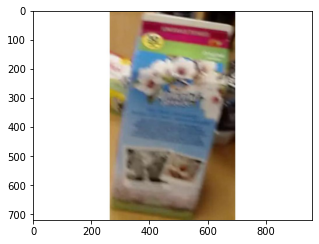

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.4246


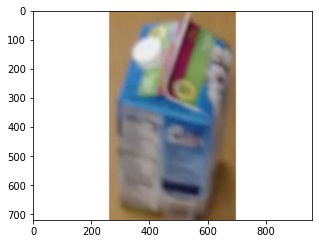

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.947


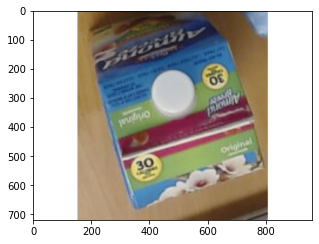

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7793


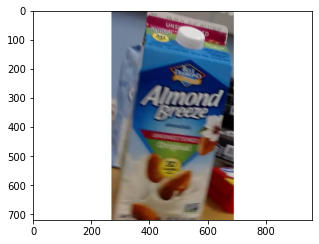

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.996


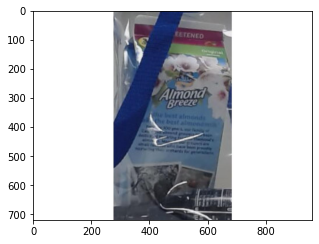

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.285


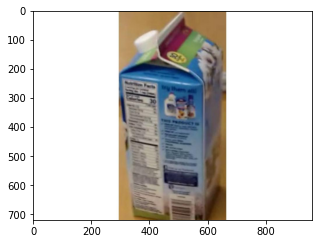

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.9116


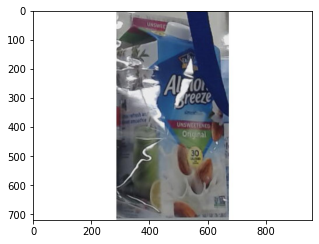

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.994


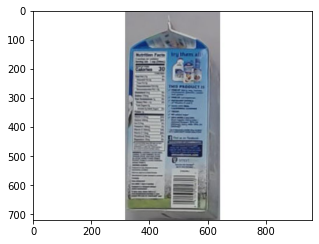

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.338


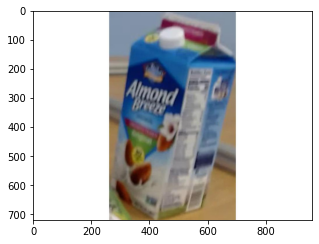

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9927


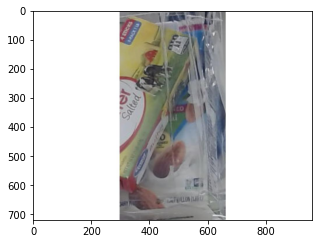

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.3704


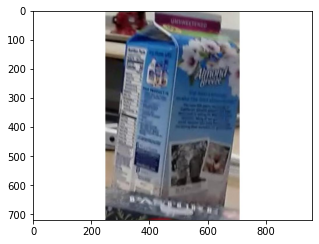

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4385


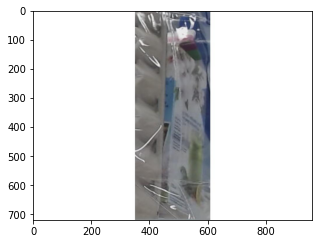

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4124


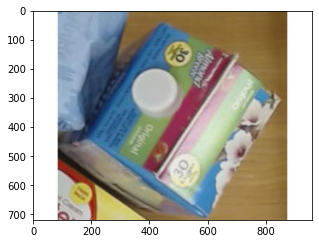

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4595


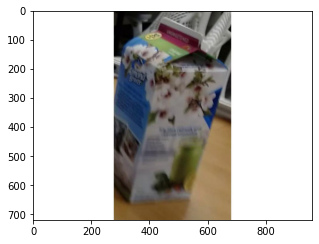

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.508


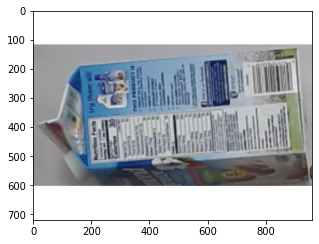

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4956


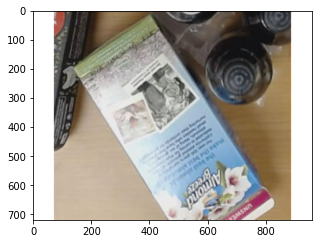

4157005670-almondmilk :   predicted as  7874212406-sweetner 0.3162


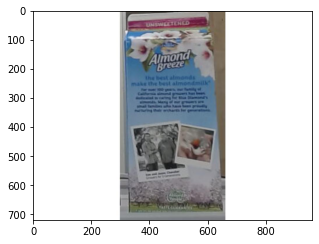

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.875


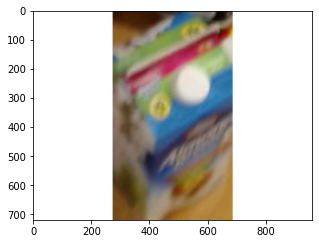

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.549


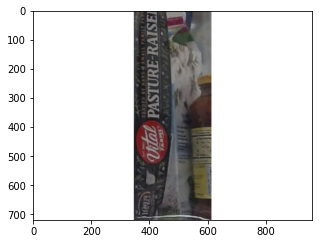

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.2988


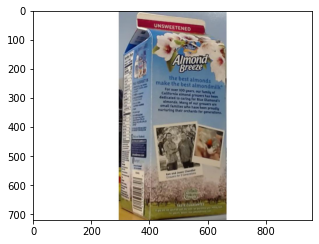

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9604


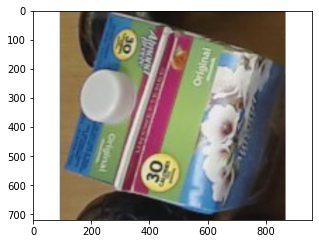

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.847


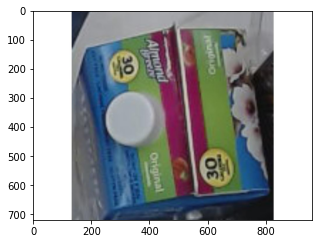

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.3452


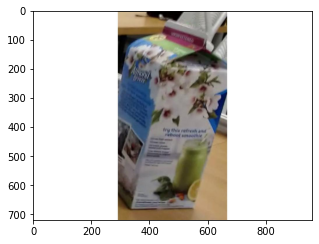

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4026


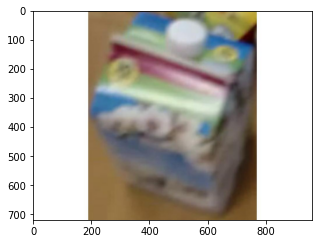

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.521


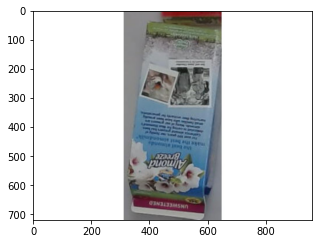

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.463


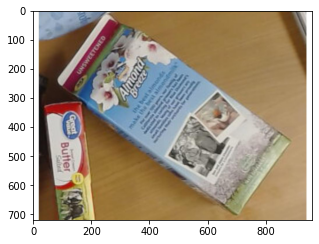

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4246


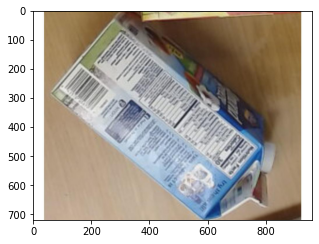

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.967


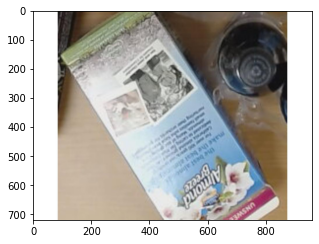

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.3647


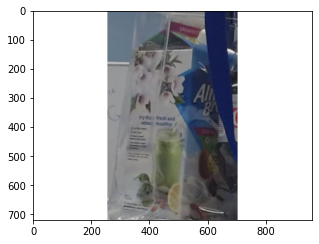

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.3203


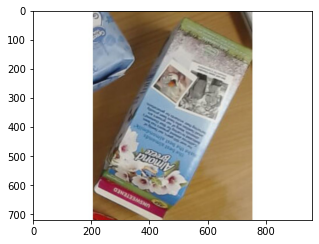

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.3428


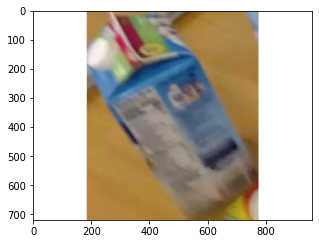

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.509


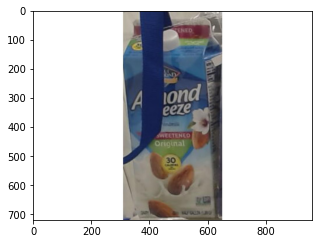

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.575


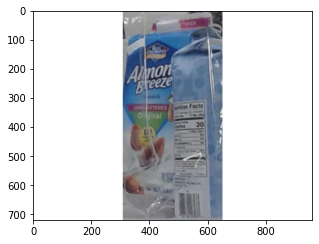

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.418


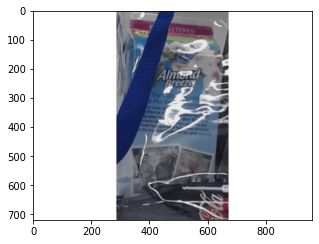

4157005670-almondmilk :   predicted as  4288742634-dishwasherCleaner 0.3987


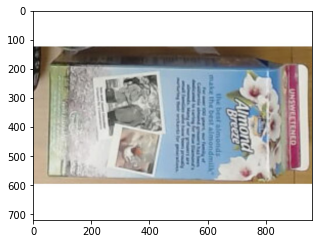

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.5347


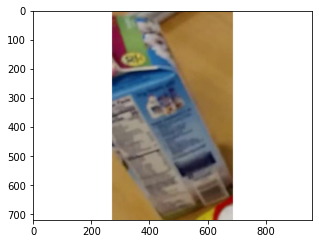

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.798


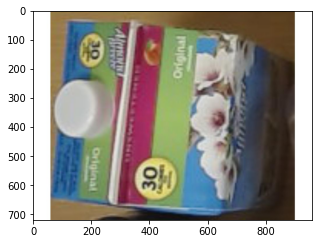

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.785


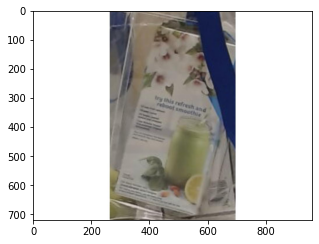

4157005670-almondmilk :   predicted as  22222-Banana 0.3015


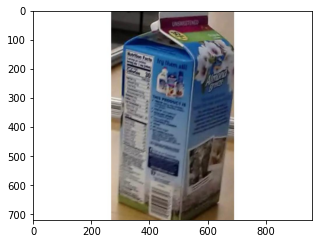

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.49


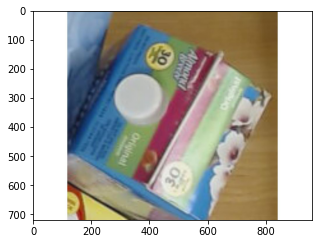

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.3374


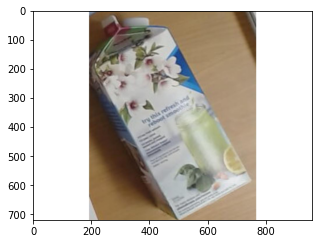

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.626


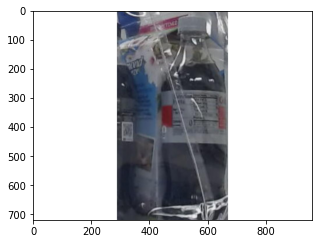

4157005670-almondmilk :   predicted as  84576204143-galaApple 0.242


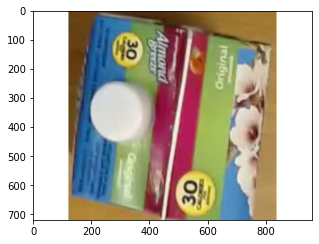

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.6235


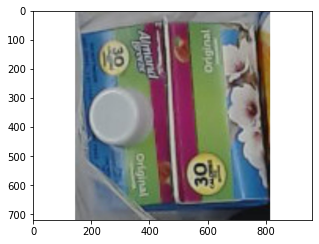

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.2783


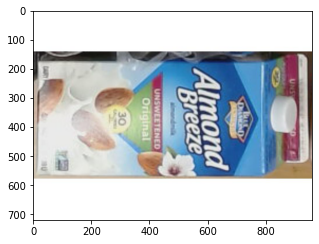

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.5327


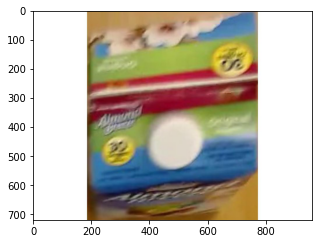

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.715


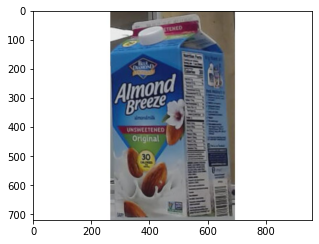

4157005670-almondmilk :   predicted as  4157005670-almondmilk 1.0


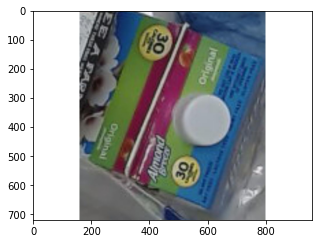

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.8315


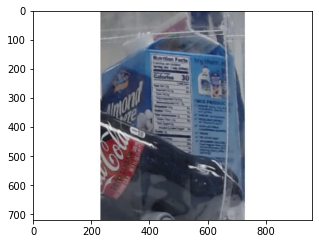

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.3503


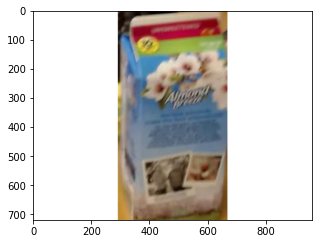

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.5244


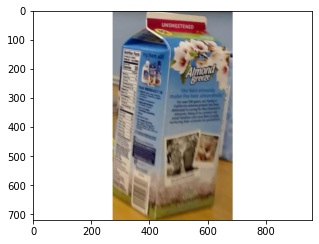

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.8174


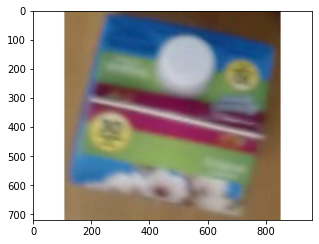

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.5884


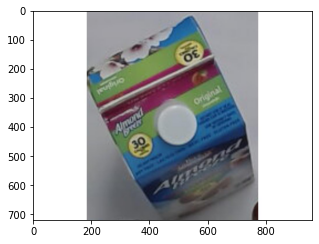

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.528


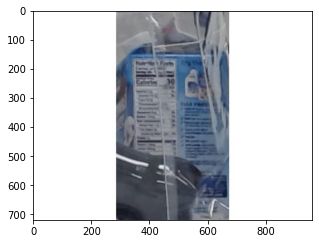

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.3752


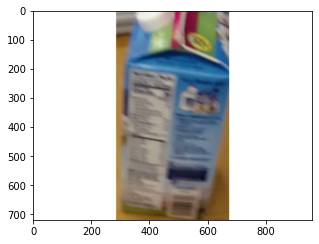

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.8906


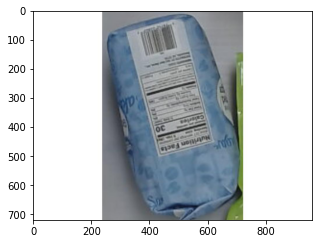

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.2368


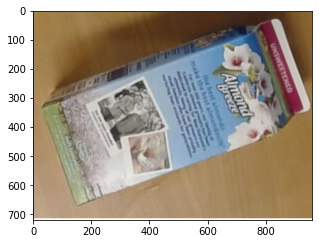

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.6562


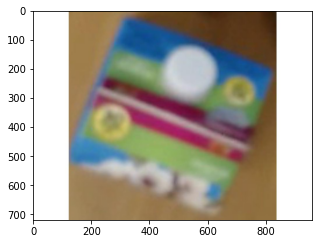

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.662


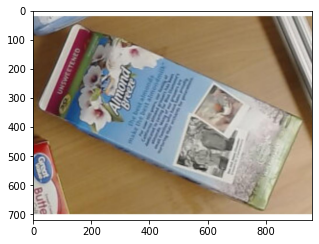

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.6826


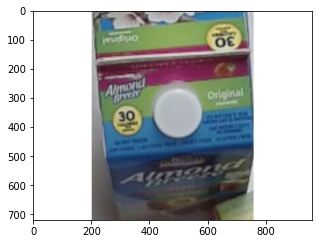

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.3853


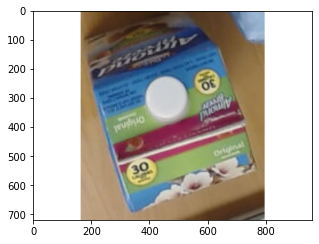

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7056


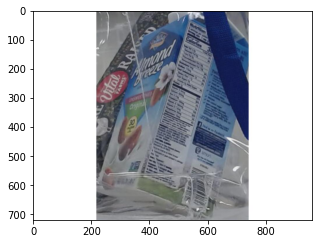

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.828


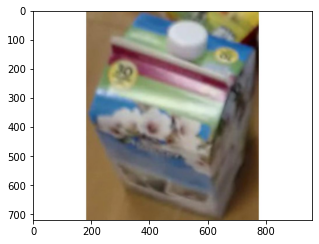

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.626


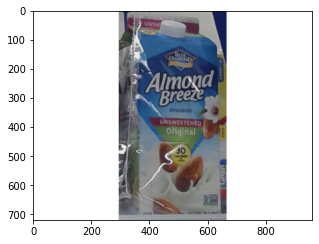

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9946


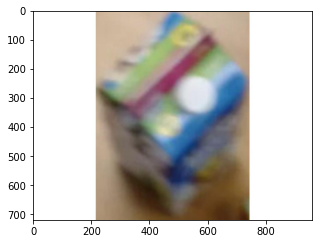

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.554


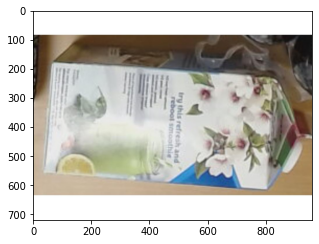

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.243


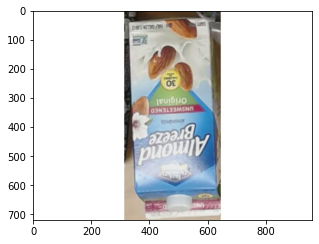

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.706


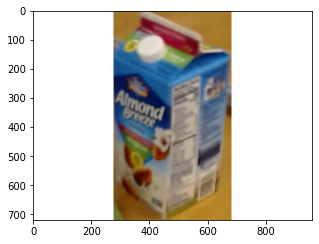

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.8525


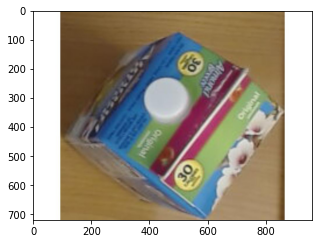

4157005670-almondmilk :   predicted as  33333-Butter 0.2722


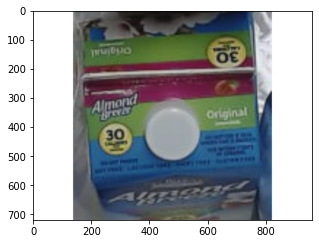

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.7393


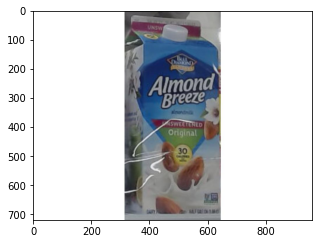

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9995


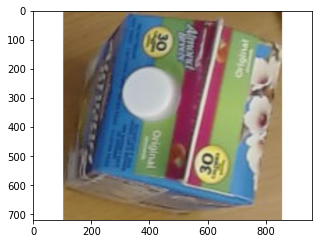

4157005670-almondmilk :   predicted as  33333-Butter 0.2542


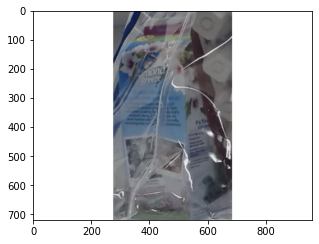

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.3066


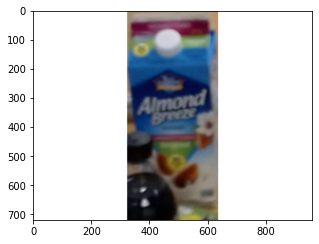

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9976


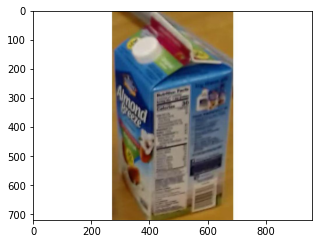

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7993


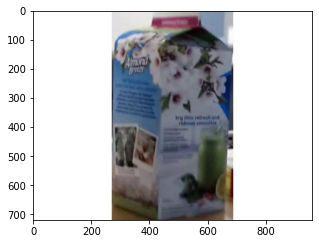

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7065


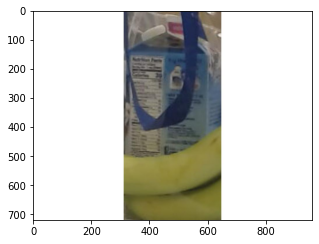

4157005670-almondmilk :   predicted as  22222-Banana 0.8525


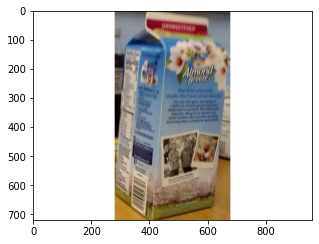

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.8716


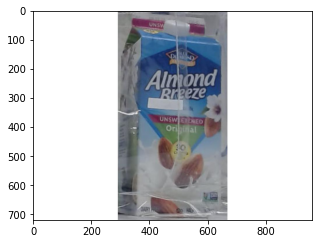

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9976


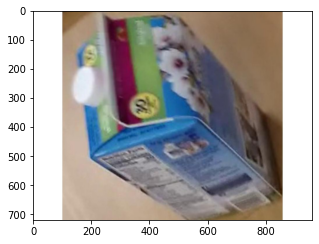

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4749


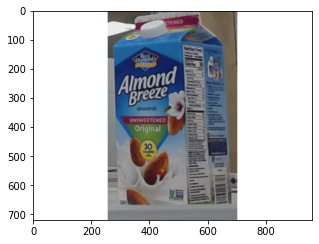

4157005670-almondmilk :   predicted as  4157005670-almondmilk 1.0


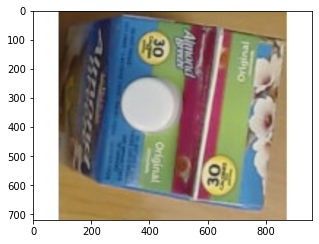

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.519


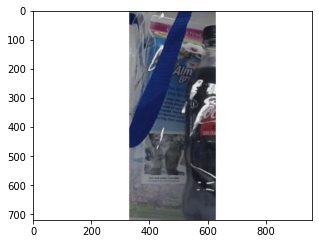

4157005670-almondmilk :   predicted as  4288742634-dishwasherCleaner 0.4788


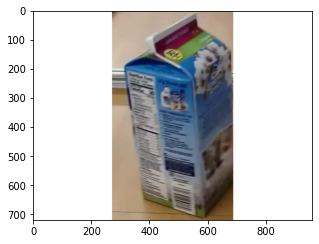

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.862


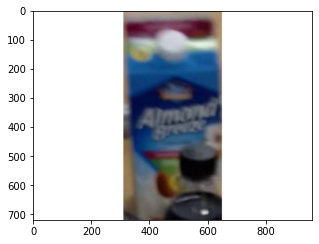

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.992


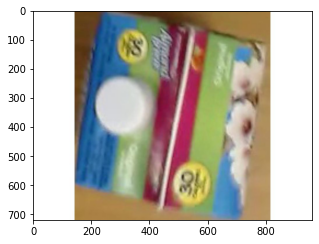

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.68


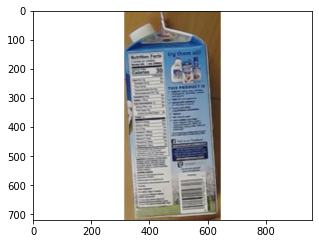

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.672


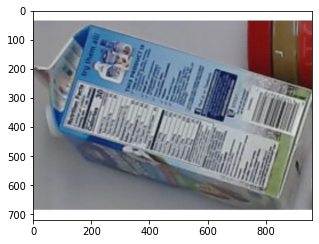

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7456


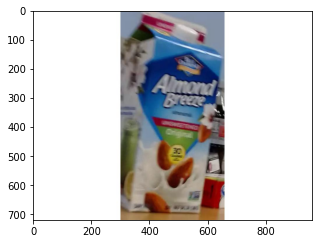

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.8706


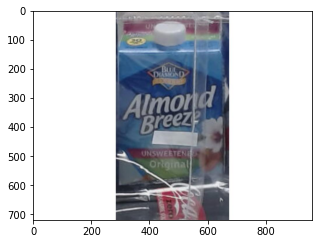

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.994


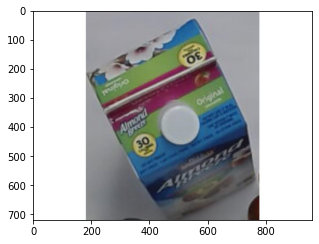

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.3237


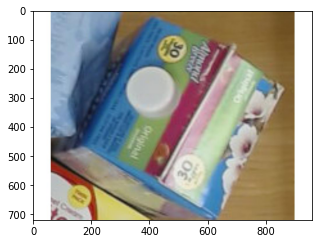

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.3657


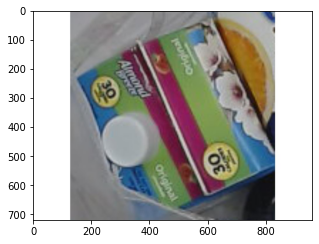

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.381


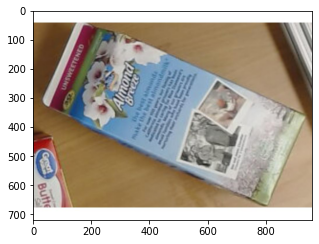

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.619


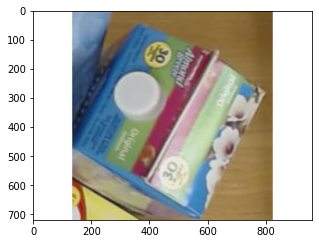

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.3396


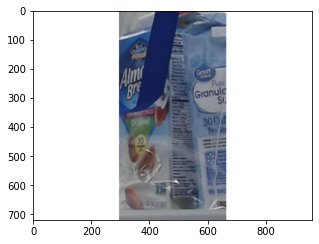

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.2042


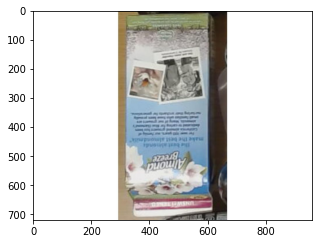

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.609


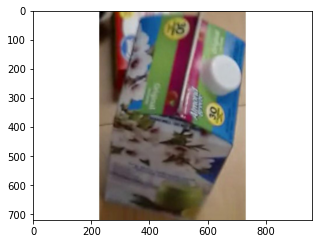

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.9253


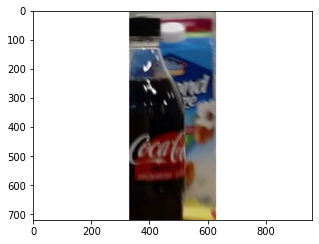

4157005670-almondmilk :   predicted as  55555-Coke 0.644


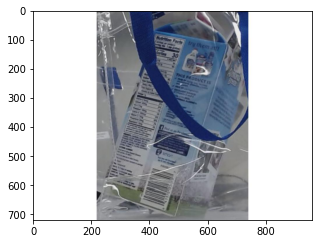

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.1917


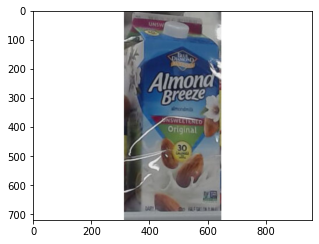

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.82


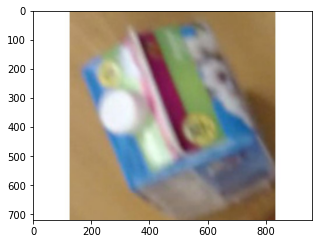

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.309


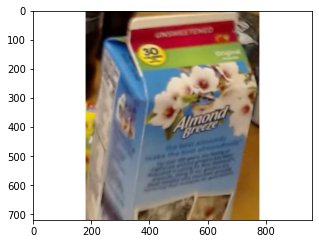

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.866


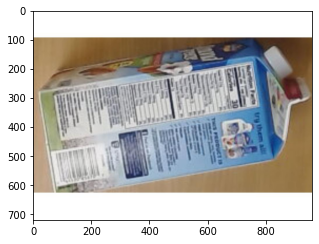

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4807


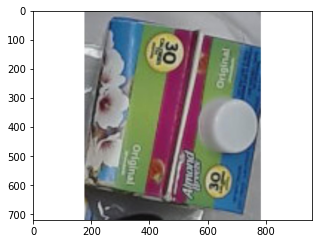

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.4285


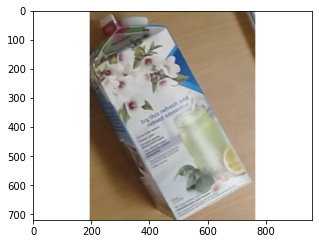

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7817


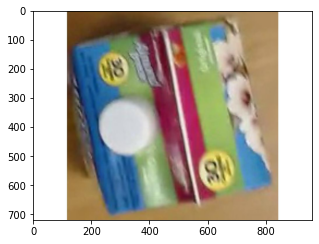

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.4426


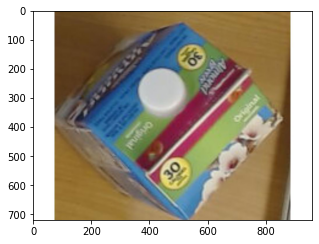

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.2996


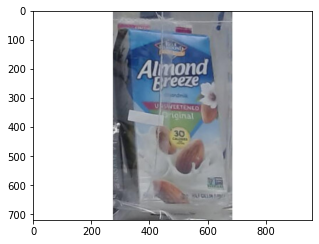

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9995


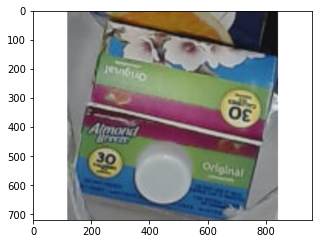

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.3933


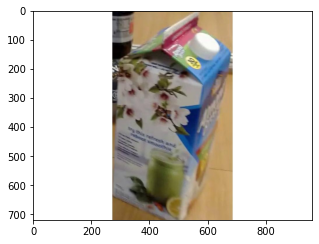

4157005670-almondmilk :   predicted as  9413844-FujiApple 0.3884


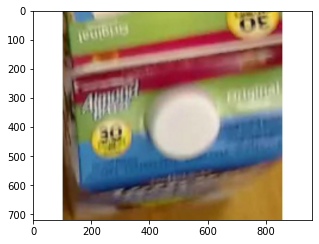

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.718


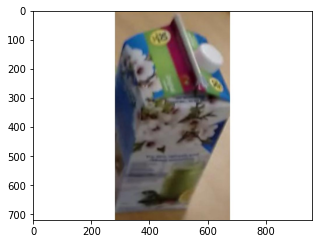

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.448


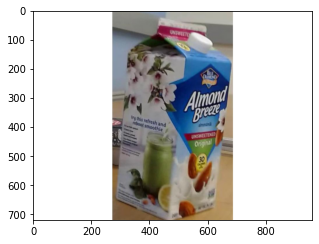

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9917


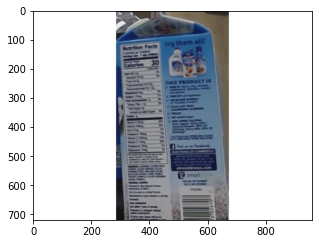

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.448


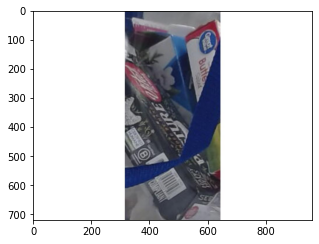

4157005670-almondmilk :   predicted as  4288742634-dishwasherCleaner 0.294


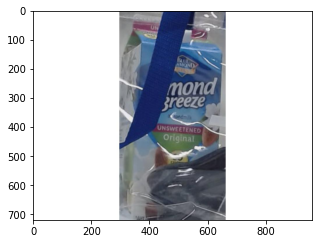

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.594


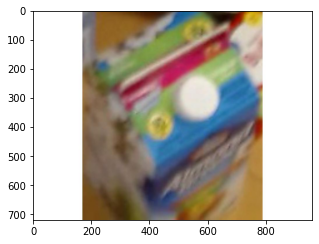

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4321


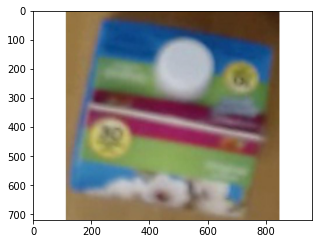

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.4492


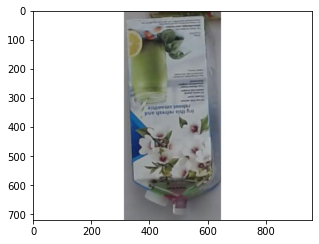

4157005670-almondmilk :   predicted as  1920089962-SurfaceCleaner 0.584


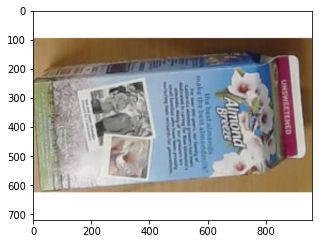

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.3535


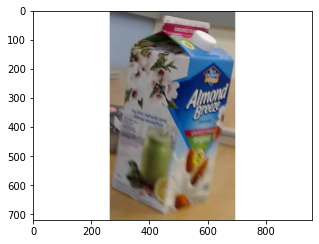

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.8516


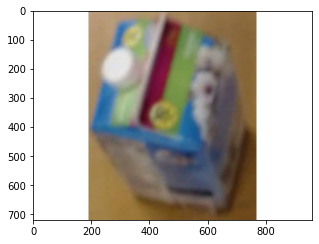

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.4116


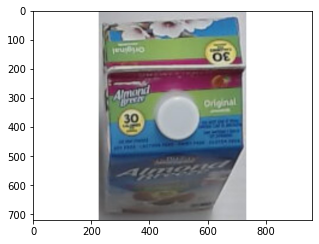

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.4155


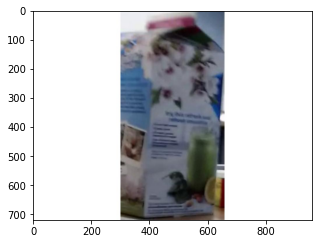

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.756


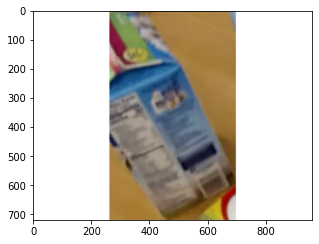

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.832


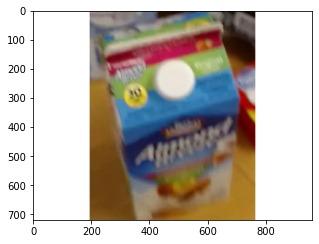

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.7935


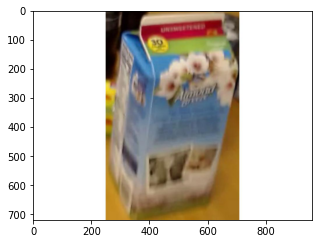

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.502


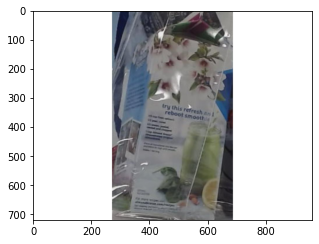

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.333


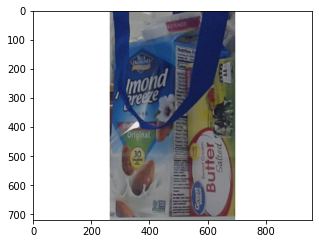

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.49


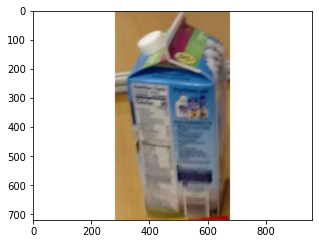

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.667


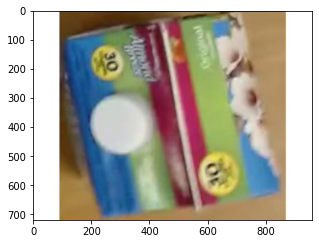

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.628


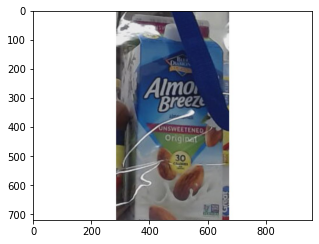

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9536


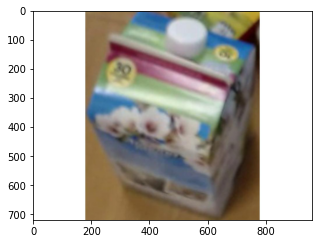

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.4722


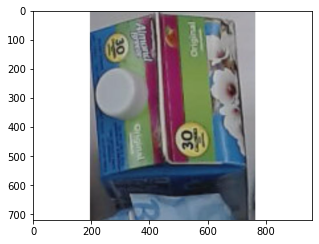

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.7163


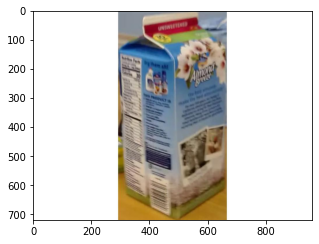

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.3003


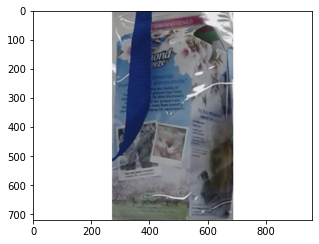

4157005670-almondmilk :   predicted as  7874222803-sugar 0.3994


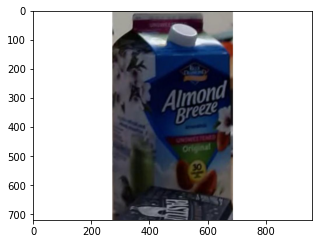

4157005670-almondmilk :   predicted as  4157005670-almondmilk 1.0


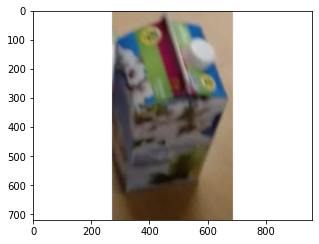

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.852


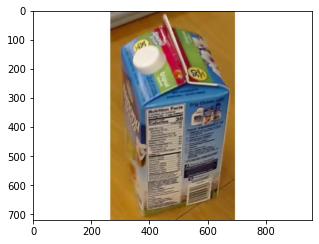

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.823


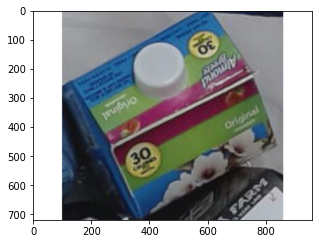

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7275


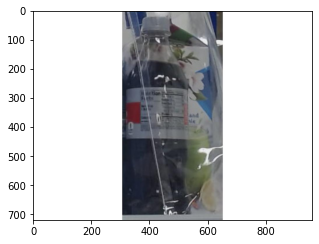

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.5063

accuracy on class 4157005670-almondmilk is :0.18791946308724833

no picture are found for 8491201426-HoneyBunch

no picture are found for 8113118392-tussin

no picture are found for 8113106123-tussin_max

no picture are found for 7874212406-sweetner

no picture are found for 1015803449-Cleanser

no picture are found for 4400004575-RitzCracker

no picture are found for 3600041777-Wipes

no picture are found for 41331112406-Beans

no picture are found for 1411391254-Pistachios

no picture are found for 8616220043-water

no picture are found for 7203002209-littleBite

no picture are found for 4000055113-m&mMilk

no picture are found for 1800012323-miniBiscuits

no picture are found for 4000051121-m&mPeanut

no picture are found for 3528244925-toyPenguin

no picture are found for 1920089962-SurfaceCleaner

no picture are found for 1600017819-berryCereal

no picture are found for 5000015991-evaporatedMilk

no picture 

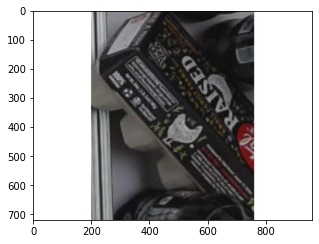

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.3188


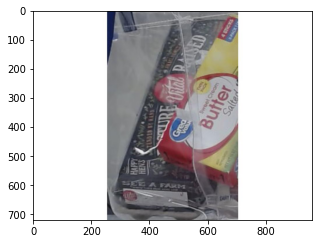

11111-Egg :   predicted as  1370037299-Ziplock 0.6733


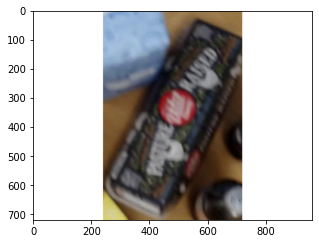

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.2244


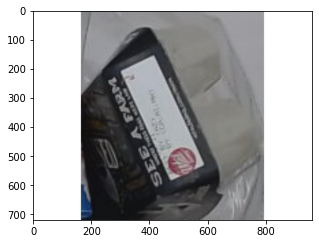

11111-Egg :   predicted as  84576204143-galaApple 0.277


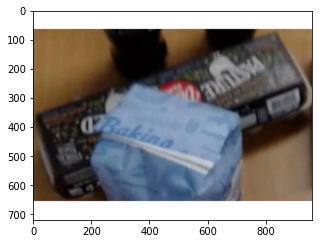

11111-Egg :   predicted as  55555-Coke 0.2783


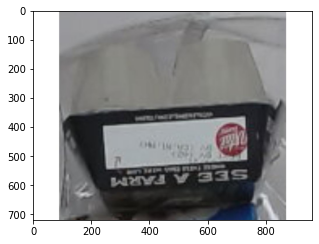

11111-Egg :   predicted as  7874212406-sweetner 0.264


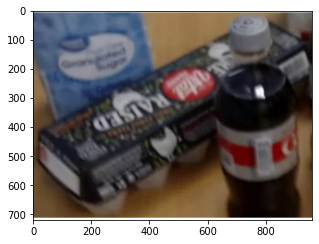

11111-Egg :   predicted as  44444-DietCoke 0.8174


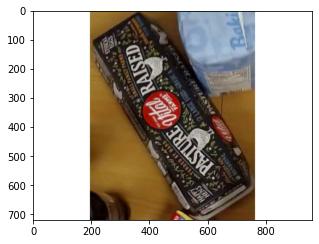

11111-Egg :   predicted as  7314115315-oreoPocky 0.614


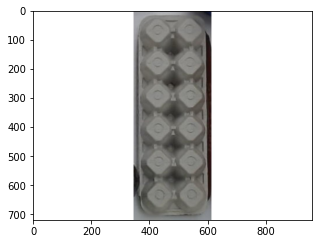

11111-Egg :   predicted as  1370037299-Ziplock 0.2874


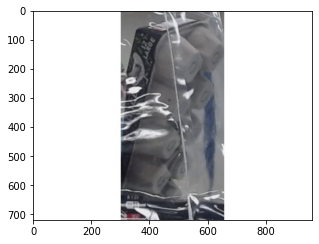

11111-Egg :   predicted as  84576204143-galaApple 0.3013


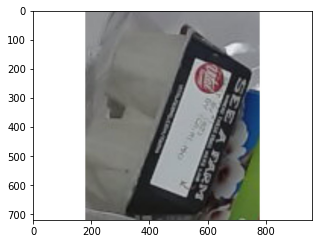

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.3406


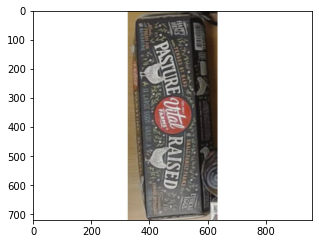

11111-Egg :   predicted as  4400004575-RitzCracker 0.241


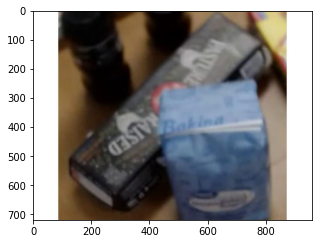

11111-Egg :   predicted as  55555-Coke 0.3335


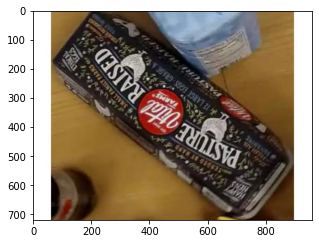

11111-Egg :   predicted as  44444-DietCoke 0.5933


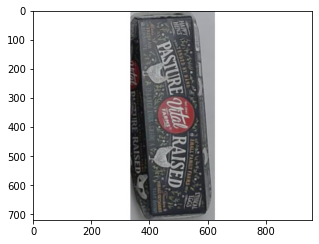

11111-Egg :   predicted as  7874212406-sweetner 0.306


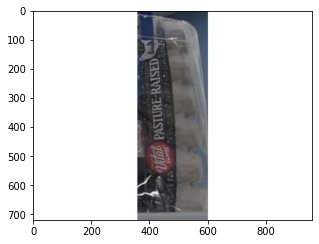

11111-Egg :   predicted as  6416410193-BlueBerryBun 0.5386


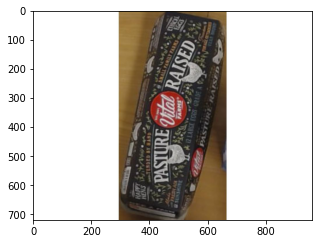

11111-Egg :   predicted as  7874212406-sweetner 0.271


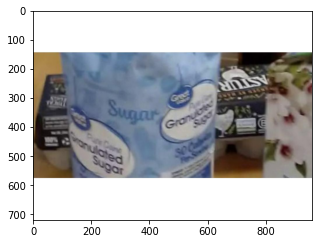

11111-Egg :   predicted as  7874222803-sugar 0.6826


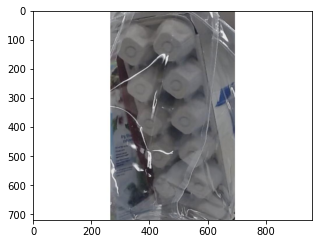

11111-Egg :   predicted as  7203002209-littleBite 0.4402


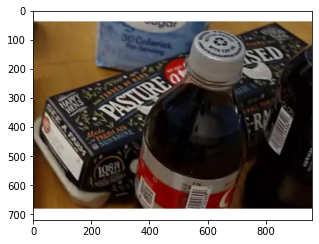

11111-Egg :   predicted as  44444-DietCoke 0.5454


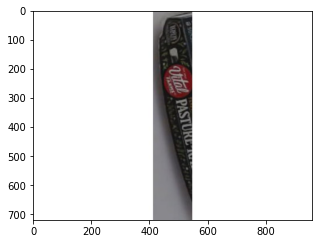

11111-Egg :   predicted as  7314115315-oreoPocky 0.2252


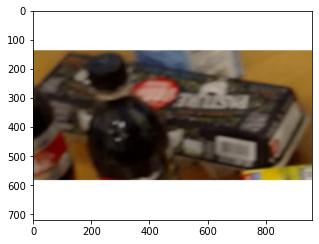

11111-Egg :   predicted as  55555-Coke 0.3376


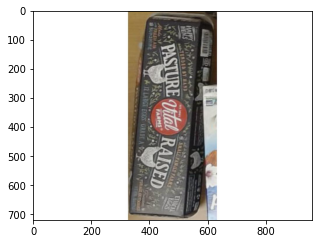

11111-Egg :   predicted as  4000055113-m&mMilk 0.279


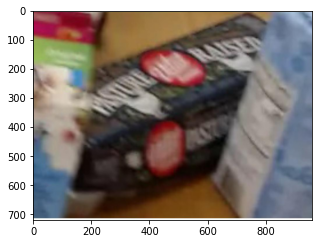

11111-Egg :   predicted as  44444-DietCoke 0.4788


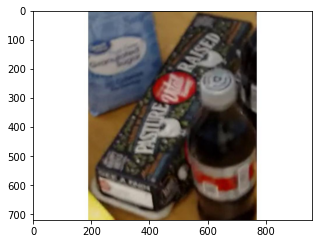

11111-Egg :   predicted as  44444-DietCoke 0.589


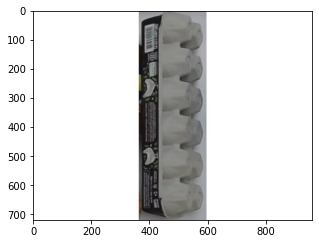

11111-Egg :   predicted as  7314115315-oreoPocky 0.3806


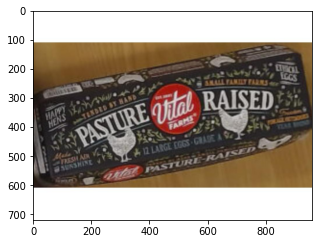

11111-Egg :   predicted as  11111-Egg 0.8013


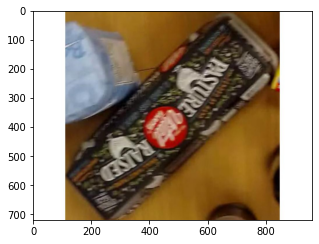

11111-Egg :   predicted as  55555-Coke 0.3904


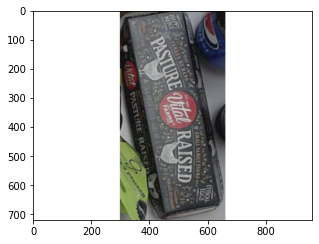

11111-Egg :   predicted as  7874212406-sweetner 0.4531


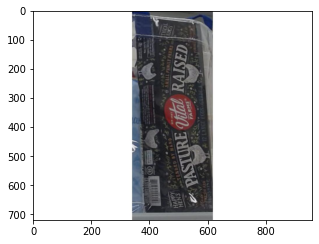

11111-Egg :   predicted as  1370037299-Ziplock 0.689


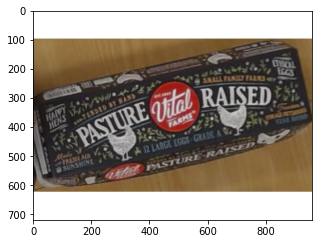

11111-Egg :   predicted as  11111-Egg 0.8335


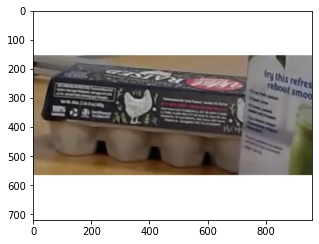

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.2927


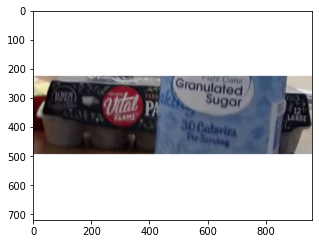

11111-Egg :   predicted as  7874222803-sugar 0.8076


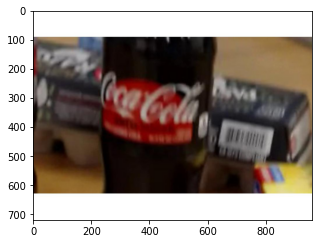

11111-Egg :   predicted as  55555-Coke 0.7183


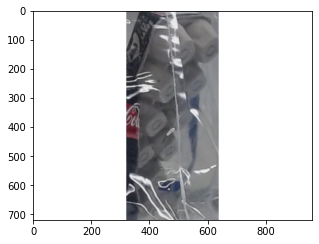

11111-Egg :   predicted as  1370037299-Ziplock 0.327


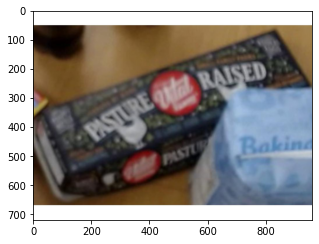

11111-Egg :   predicted as  33333-Butter 0.377


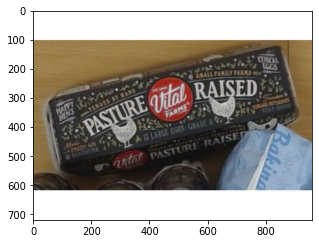

11111-Egg :   predicted as  33333-Butter 0.4702


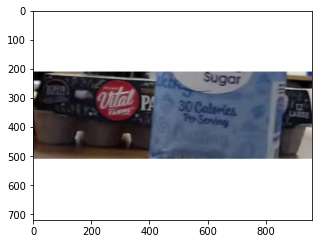

11111-Egg :   predicted as  7874222803-sugar 0.413


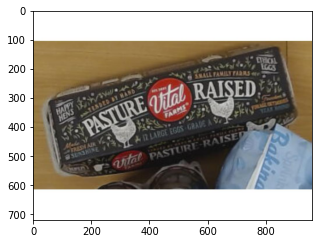

11111-Egg :   predicted as  33333-Butter 0.693


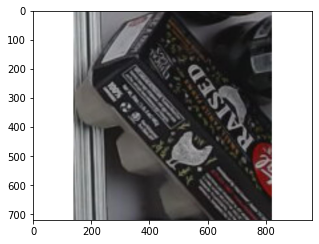

11111-Egg :   predicted as  7232075003-pandaCookie 0.2698


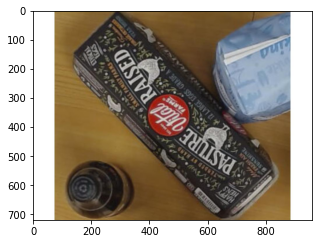

11111-Egg :   predicted as  44444-DietCoke 0.306


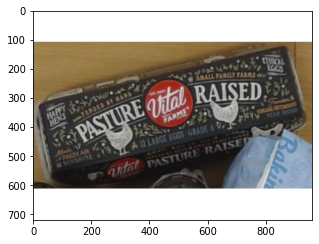

11111-Egg :   predicted as  11111-Egg 0.333


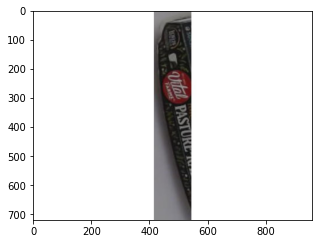

11111-Egg :   predicted as  7314115315-oreoPocky 0.2449


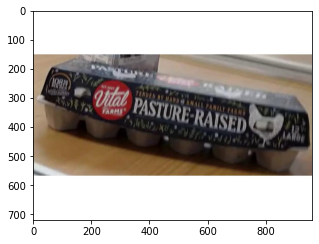

11111-Egg :   predicted as  11111-Egg 0.9272


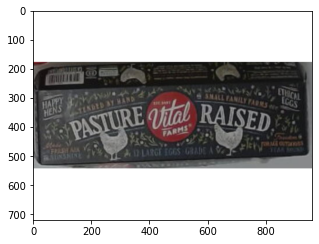

11111-Egg :   predicted as  11111-Egg 0.587


In [ ]:
# Enroll new product{class:description}
product_descriptions = {"7874222803-sugar": "Great Value Pure Granulated Sugar 4 lb",
            "4157005670-almondmilk": "Blue Diamond Almond Breeze milk Unsweetened Original Almond Milk, Half Gallon, 64 fl oz",
            "8491201426-HoneyBunch": "Honey Bunches of Oats Honey Roasted Heart Healthy Low Fat made with Whole Grain Cereal, 18 ounce",
            "8113118392-tussin": "Equate Tussin Cough Syrup DM Cough Suppressant and Expectorant Wild Cherry Flavor 8 fl oz",
            "8113106123-tussin_max": "Equate Tussin DM Cough Cold Raspberry Menthrol Flavor, 4 fl Oz",
            "7874212406-sweetner": "great value no calorie sweenter 200 count 7 oz",
            "1015803449-Cleanser":"Polident Overnight Whitening Antibacterial Denture Cleanser Tablets,120 Count",
            "4400004575-RitzCracker": "Ritz Fresh Stacks Original Crackers Family Size, 17.8 Oz",
            "3600041777-Wipes": "Cottonelle Flushable Wet Wipes for Adults, 1 Refill Pack, 168 Flushable Wipes",
            "41331112406-Beans": "Goya Pink Beans 15.5 Oz",
            "1411391254-Pistachios":"Wonderful Pistachios No Shell Roasted & Salted 12 Oz",
            "8616220043-water":"smartwater nutrient-enhanced water bottle, 20 fl oz",
            "7203002209-littleBite":"Entenmann Little Bites Party Cake Muffin 5 Pouches per Box",
            "4000055113-m&mMilk":"M&M's Milk Chocolate Candy, Party size-38 oz Bag",
            "1800012323-miniBiscuits":"Pillsbury Chocolate Chip Mini Sweet Biscuits 7 pouches 28ct",
            "4000051121-m&mPeanut": "M&M's Peanut Milk Chocolate Candy, Family Size-19.2 oz Bag",
            "3528244925-toyPenguin": "Munchkin Wind Up Swimming Penguim Bath Toy, Color May Vary",
            "1920089962-SurfaceCleaner": "Lysol Clean & Fresh Multi-Surface Cleaner, Lemon & Sunflower, 48oz",
            "1600017819-berryCereal": "Franken Berry Breakfast Cereal, 16 oz Box",
            "5000015991-evaporatedMilk": "Nestle Carnation Lowfact 2% Evapotared Milk 12 fl oz",
            "7314115315-oreoPocky": "Glico Pocky Cookies and Cream Covered Biscuit Stickes, 1.41oz",
            "7232075003-pandaCookie": "Meiji Hello Panda Cookies Strawberry Creame, 2.1 Oz",
            "787423717-taco": "Great Value Taco Seasoning Mix 1.25 oz",
            "4300020056-limeJello": "Jell-O Lime Gelatin Dessert Mix, 6 oz Box",
            "4300020053-cherryJello": "Jell-O Cherry Gelatin Dessert Mix, 6 oz Box",
            "1370037299-Ziplock": "Hefty Slider Freezer Storage Bags, Quart Size, 25 Count",
            "4288742634-dishwasherCleaner": "Plink Appliance Cleaner, Best Brands",
            "000000-lemon":"Lemons each",
            "6416410193-BlueBerryBun": "Ozery Bakery Blueberry Snacking Rounds 10.6 Oz 12 Buns",
            "84576204143-galaApple": "Gala Apple 3lb Bag",
            "800016643095-Chips": "Jack'n Jill Chips Barbecue 3.88 Oz",
            "9413844-FujiApple": "Fuji Apples Bulk",
            "11111-Egg": "Vital Farms Pasture Raised Large Brown Grade A Eggs, 12 Count",
            "22222-Banana": "Organic Bananas, Bunc",
            "33333-Butter": "Great Value Salted Sweet Cream Butter, 16 oz, 4 Sticks",
            "44444-DietCoke": "Diet Coke",
            "55555-Coke": "coke"}

print(list(product_descriptions.keys()))
print(list(product_descriptions.values()))

%matplotlib inline

import torch
import clip
from PIL import Image
import glob
import matplotlib.pyplot as plt

def argmax(iterable):
    return max(enumerate(iterable), key=lambda x: x[1])[0]

device = "cuda" if torch.cuda.is_available() else "cpu"
model, transform = clip.load("ViT-B/32", device=device)

correct = []

#define our target classificaitons, you can should experiment with these strings of text as you see fit, though, make sure they are in the same order as your class names above
class_names = list(product_descriptions.keys())
candidate_captions = list(product_descriptions.values())
text = clip.tokenize(candidate_captions).to(device)
y_true = []
y_pred = []
for cls in class_names:
    class_correct = []
    test_imgs = glob.glob('./roboflowIsoObj_Clip/train/' + cls + '/*.jpg')

    for img in test_imgs:
        image = transform(Image.open(img)).unsqueeze(0).to(device)
        with torch.no_grad():
            image_features = model.encode_image(image)
            text_features = model.encode_text(text)

            logits_per_image, logits_per_text = model(image, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()

            pred = class_names[argmax(list(probs)[0])]
            im = Image.open(img)
            plt.figure(figsize=(5,5))
            plt.imshow(im)
            plt.show()

            print(cls, ": "," predicted as ", pred, max(list(probs)[0]) )
            if pred == cls:
                correct.append(1)
                class_correct.append(1)
            else:
                correct.append(0)
                class_correct.append(0)
            y_true.append(cls)
            y_pred.append(pred)
    
    if len(class_correct) !=0:
        print('\naccuracy on class ' + cls + ' is :' + str(sum(class_correct)/len(class_correct)))
    else: 
        print('\nno picture are found for ' + cls)
print('\naccuracy on all is : ' + str(sum(correct)/len(correct)))


In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_true, y_pred, labels = class_names)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)
plt.show()

In [ ]:
len(class_correct)

# Run with Realsense D435i Streaming

### 1. Tried custom text embedding

In [ ]:
# Check available model
clip.available_models()

### 2. Tried Walmart product name from catalogue item file for text embebdding

In [ ]:
import pyrealsense2 as rs
import cv2
import numpy as np
import torch
import clip
from PIL import Image

# upload a clip model

device = "cuda" if torch.cuda.is_available() else "cpu"
model, transform = clip.load("ViT-B/32", device=device)

# Enroll new product {upc: walmart product name}
product_descriptions = {"7874222803-sugar": "Great Value Pure Granulated Sugar 4 lb",
            "4157005670-almondmilk": "Blue Diamond Almond Breeze milk Unsweetened Original Almond Milk, Half Gallon, 64 fl oz",
            "8491201426-HoneyBunch": "Honey Bunches of Oats Honey Roasted Heart Healthy Low Fat made with Whole Grain Cereal, 18 ounce",
            "8113118392-tussin": "Equate Tussin Cough Syrup DM Cough Suppressant and Expectorant Wild Cherry Flavor 8 fl oz",
            "8113106123-tussin_max": "Equate Tussin DM Cough Cold Raspberry Menthrol Flavor, 4 fl Oz",
            "7874212406-sweetner": "great value no calorie sweenter 200 count 7 oz",
            "1015803449-Cleanser":"Polident Overnight Whitening Antibacterial Denture Cleanser Tablets,120 Count",
            "4400004575-RitzCracker": "Ritz Fresh Stacks Original Crackers Family Size, 17.8 Oz",
            "3600041777-Wipes": "Cottonelle Flushable Wet Wipes for Adults, 1 Refill Pack, 168 Flushable Wipes",
            "41331112406-Beans": "Goya Pink Beans 15.5 Oz",
            "1411391254-Pistachios":"Wonderful Pistachios No Shell Roasted & Salted 12 Oz",
            "8616220043-water":"smartwater nutrient-enhanced water bottle, 20 fl oz",
            "7203002209-littleBite":"Entenmann Little Bites Party Cake Muffin 5 Pouches per Box",
            "4000055113-m&mmilkchocolate":"M&M's Milk Chocolate Candy, Party size-38 oz Bag",
            "1800012323-miniBiscuits":"Pillsbury Chocolate Chip Mini Sweet Biscuits 7 pouches 28ct",
            "4000051121-m&mPeanutChoco": "M&M's Peanut Milk Chocolate Candy, Family Size-19.2 oz Bag",
            "3528244925-toyPenguin": "Munchkin Wind Up Swimming Penguim Bath Toy, Color May Vary",
            "1920089962-SurfaceCleaner": "Lysol Clean & Fresh Multi-Surface Cleaner, Lemon & Sunflower, 48oz",
            "1600017819-berryCereal": "Franken Berry Breakfast Cereal, 16 oz Box",
            "5000015991-evaporatedMilk": "Nestle Carnation Lowfact 2% Evapotared Milk 12 fl oz",
            "7314115315-oreoPocky": "Glico Pocky Cookies and Cream Covered Biscuit Stickes, 1.41oz",
            "7232075003-pandaCookie": "Meiji Hello Panda Cookies Strawberry Creame, 2.1 Oz",
            "787423717-taco": "Great Value Taco Seasoning Mix 1.25 oz",
            "4300020056-limeJello": "Jell-O Lime Gelatin Dessert Mix, 6 oz Box",
            "4300020053-cherryJello": "Jell-O Cherry Gelatin Dessert Mix, 6 oz Box",
            "1370037299-Ziplock": "Hefty Slider Freezer Storage Bags, Quart Size, 25 Count",
            "4288742634-dishwasherCleaner": "Plink Appliance Cleaner, Best Brands",
            "000000-lemon":"Lemons each",
            "6416410193-BlueBerryBun": "Ozery Bakery Blueberry Snacking Rounds 10.6 Oz 12 Buns",
            "84576204143-galaApple": "Gala Apple 3lb Bag",
            "800016643095-Chips": "Jack'n Jill Chips Barbecue 3.88 Oz",
            "9413844-FujiApple": "Fuji Apples Bulk"}




#define our target classificaitons
class_names = list(product_descriptions.keys())
candidate_captions = list(product_descriptions.values())
text = clip.tokenize(candidate_captions).to(device)


def argmax(iterable):
    return max(enumerate(iterable), key=lambda x: x[1])[0]

try:
    pipeline = rs.pipeline()
    config = rs.config()
    config.enable_stream(rs.stream.color, 640,480, rs.format.bgr8, 30)
    pipeline.start(config)
    
    while True:
        frames = pipeline.wait_for_frames()    
        color_image = np.asarray(frames.get_color_frame().get_data())
        
        img = Image.fromarray(color_image)

        image = transform(img).unsqueeze(0).to(device)   # transform takes PIL image only - See clip.py

        with torch.no_grad():
            image_features = model.encode_image(image)
            text_features = model.encode_text(text)
            
            logits_per_image, logits_per_text = model(image, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()

            pred = class_names[argmax(list(probs)[0])]
            prob = max(list(probs)[0])
            if prob > 0.60:
                class_str = pred + ' ' + str(prob)
            else:
                class_str = "Not recognized"
            
        cv2.namedWindow("Classifier", cv2.WINDOW_NORMAL)
        cv2.resizeWindow("Classifier", 1280, 960)
        cv2.putText(color_image, class_str, (10,25),cv2.FONT_HERSHEY_SIMPLEX,1, (0,0,255),2)

        cv2.imshow("Classifier",color_image)
        cv2.waitKey(1)
    exit(0)
except Exception as e:
    print(e)
    pass